<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
temp_array  = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 180

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        
        #if img.shape[0] != img.shape[1]:
        #    img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))

        X_train.append(image)
image_index = 0
bb_train = np.zeros((len(X_train),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                  temp_array.append(k)
                temp_array.pop(0)

                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size

                #print(temp_array)
                bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])
            image_index += 1
            count += 1

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
bb_test = np.zeros((len(X_test),4))
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)

                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])
            image_index += 1
            count_test += 1
print(bb_test[30])
print(extRight_coords_x_test[30])
print(extLeft_coords_x_test[30])

[124.42452099  66.77324418  27.7127405   30.13654925]
383
141


In [26]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
    rescale = 1./255,
    rotation_range=10,
    width_shift_range=0.05,
    height_shift_range=0.05,
    zoom_range=0.1,
    #horizontal_flip=True
    )
val_data_gen = ImageDataGenerator(rescale = 1./255
)
test_data_gen = ImageDataGenerator(rescale = 1./255
)


In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [27]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 16
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[180,180, 3])

x = input_

for i in range(10):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 180, 180, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 180, 180, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 8)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 16)        1168      
                                                                 
 batch_normalization_1 (Batc  (None, 90, 90, 16)       64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
callbacks_list = [
    ShowTestImages()
]

In [21]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)

def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [22]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/100
7/7 [==============================] - 1s 121ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 37ms/step
4


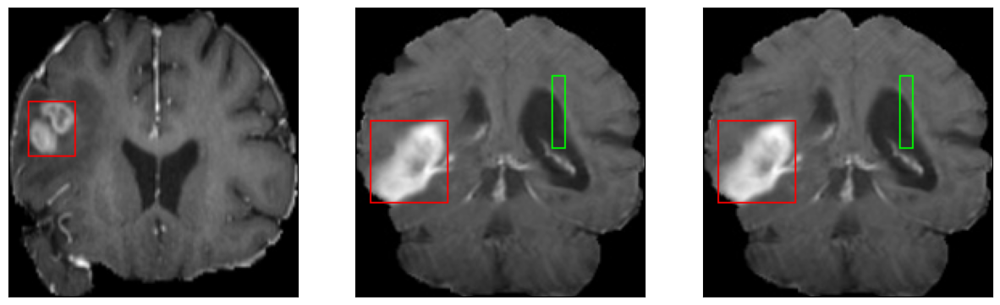

50/50 [==============================] - 33s 245ms/step - loss: 32.4029 - IoU: 0.0476 - val_loss: 51.8918 - val_IoU: 9.3436e-04
Epoch 2/100
7/7 [==============================] - 0s 37ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 37ms/step
4


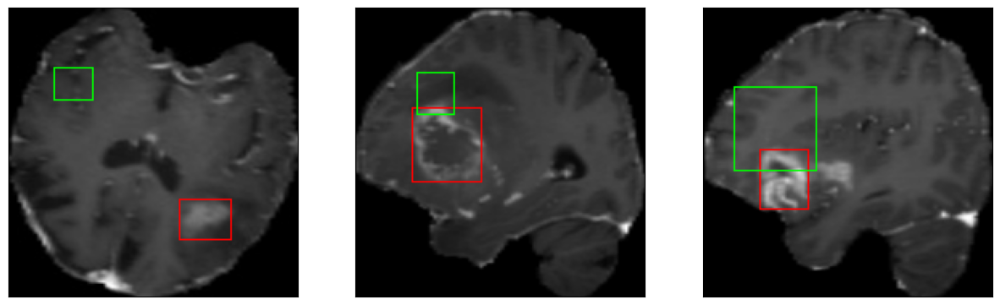

50/50 [==============================] - 9s 186ms/step - loss: 22.8856 - IoU: 0.0751 - val_loss: 27.5361 - val_IoU: 0.0544
Epoch 3/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


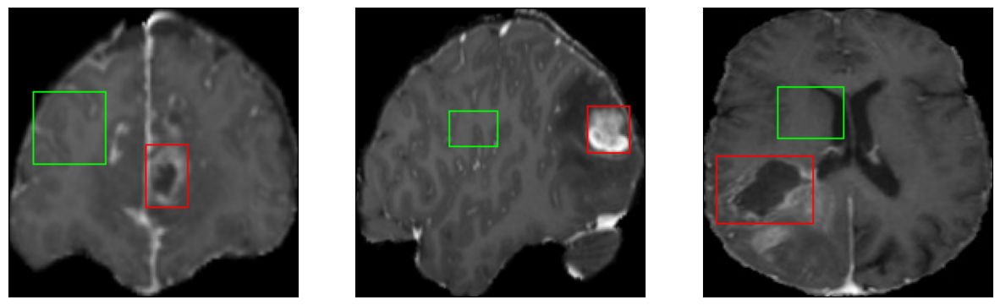

50/50 [==============================] - 9s 188ms/step - loss: 21.2325 - IoU: 0.0964 - val_loss: 22.2406 - val_IoU: 0.0723
Epoch 4/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 37ms/step
4


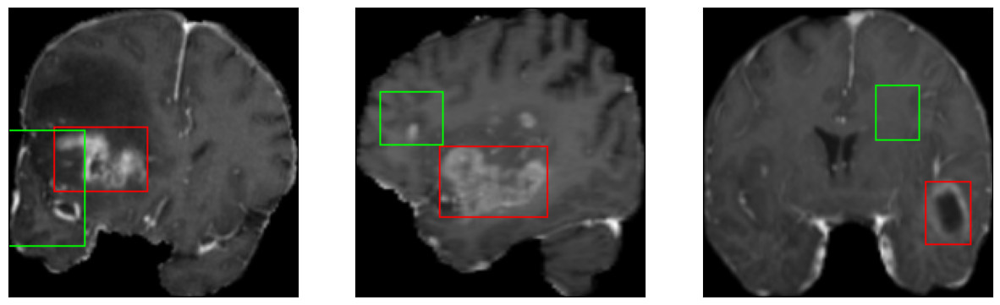

50/50 [==============================] - 9s 184ms/step - loss: 20.1904 - IoU: 0.1171 - val_loss: 25.7266 - val_IoU: 0.0934
Epoch 5/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


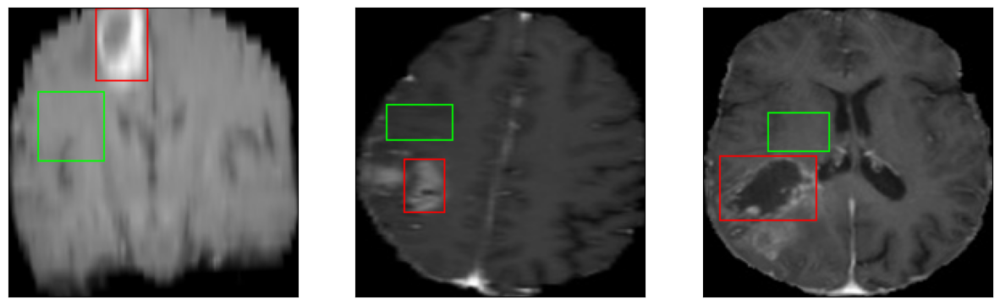

50/50 [==============================] - 9s 184ms/step - loss: 18.0103 - IoU: 0.1529 - val_loss: 18.2126 - val_IoU: 0.1688
Epoch 6/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


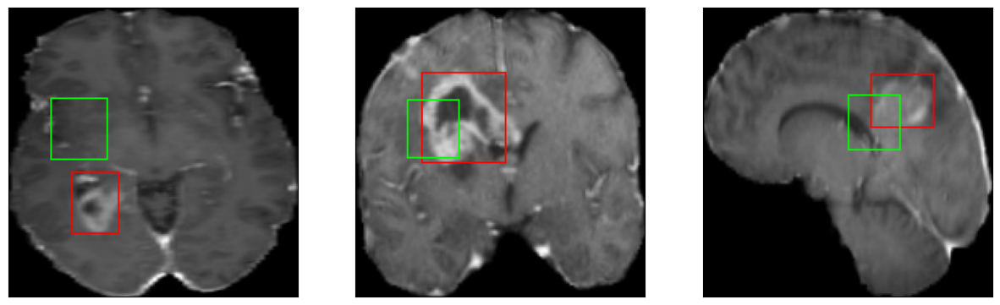

50/50 [==============================] - 9s 188ms/step - loss: 17.4839 - IoU: 0.1625 - val_loss: 21.0559 - val_IoU: 0.1188
Epoch 7/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


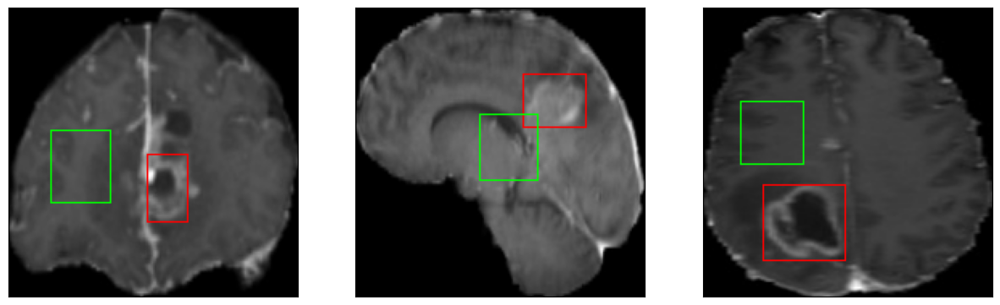

50/50 [==============================] - 10s 191ms/step - loss: 17.2947 - IoU: 0.1712 - val_loss: 20.0317 - val_IoU: 0.1277
Epoch 8/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


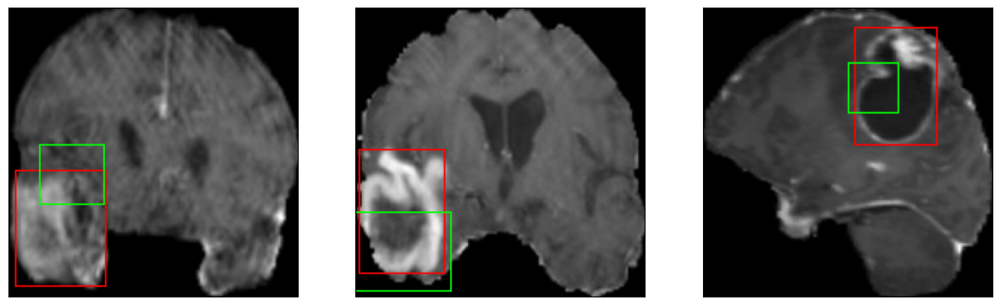

50/50 [==============================] - 9s 187ms/step - loss: 16.3622 - IoU: 0.1833 - val_loss: 16.3144 - val_IoU: 0.1490
Epoch 9/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


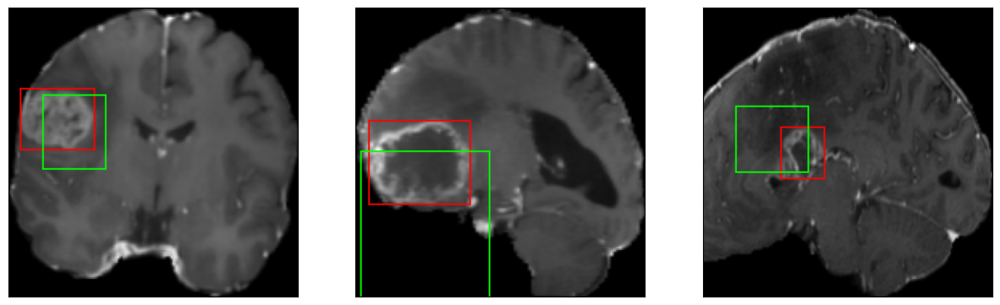

50/50 [==============================] - 9s 189ms/step - loss: 15.0339 - IoU: 0.2281 - val_loss: 20.4506 - val_IoU: 0.2253
Epoch 10/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


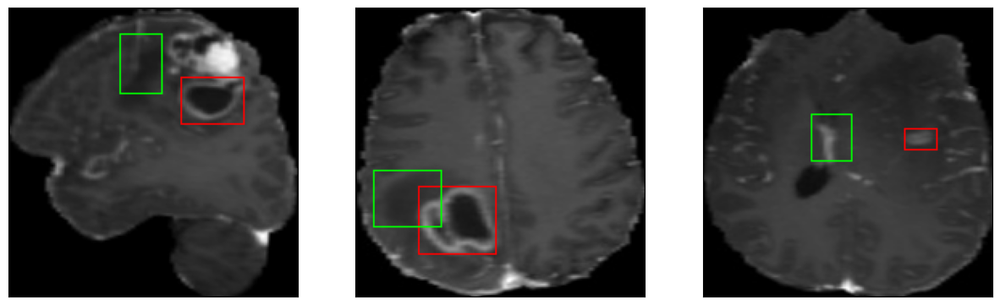

50/50 [==============================] - 10s 191ms/step - loss: 13.3386 - IoU: 0.2701 - val_loss: 15.6222 - val_IoU: 0.2510
Epoch 11/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


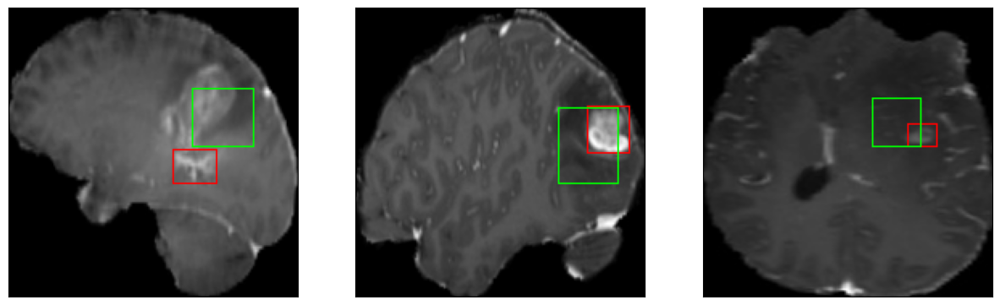

50/50 [==============================] - 9s 189ms/step - loss: 13.3582 - IoU: 0.2640 - val_loss: 15.0533 - val_IoU: 0.2326
Epoch 12/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 38ms/step
4


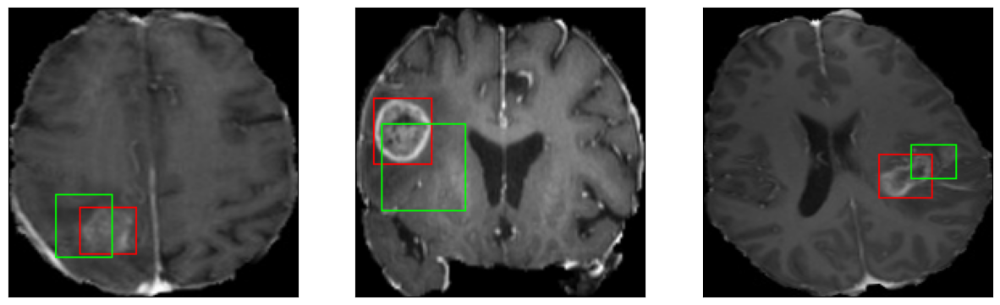

50/50 [==============================] - 9s 187ms/step - loss: 13.5392 - IoU: 0.2540 - val_loss: 12.7543 - val_IoU: 0.2888
Epoch 13/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


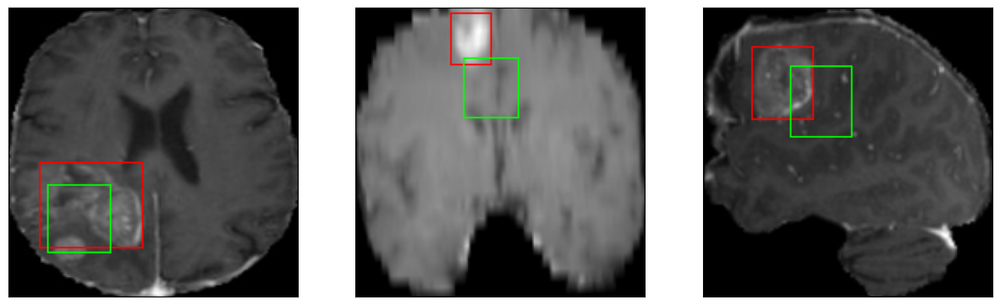

50/50 [==============================] - 9s 189ms/step - loss: 12.5671 - IoU: 0.2779 - val_loss: 11.6622 - val_IoU: 0.3144
Epoch 14/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


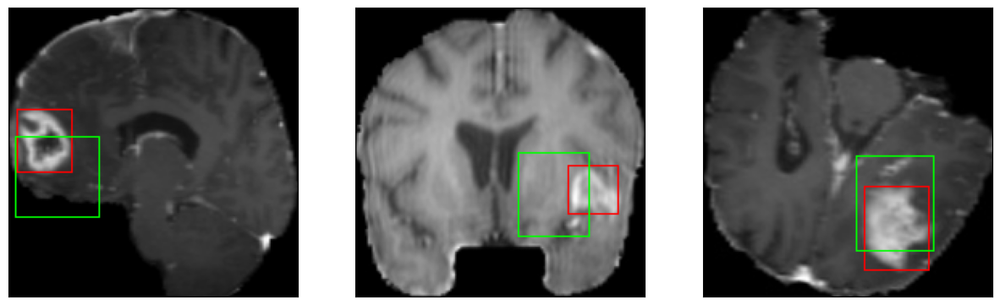

50/50 [==============================] - 10s 193ms/step - loss: 12.1028 - IoU: 0.3022 - val_loss: 12.3270 - val_IoU: 0.2792
Epoch 15/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 38ms/step
4


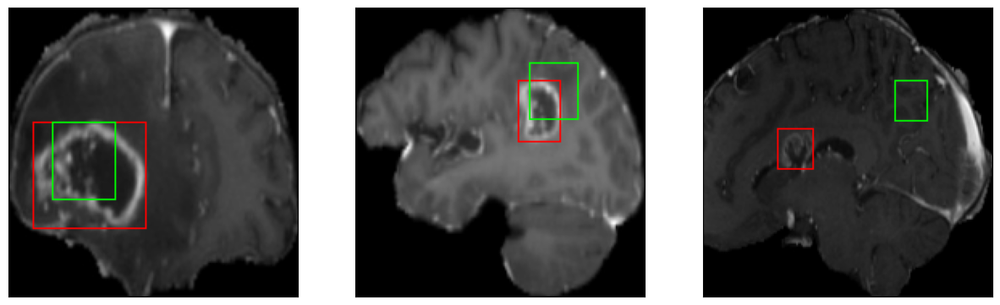

50/50 [==============================] - 9s 187ms/step - loss: 11.3002 - IoU: 0.3178 - val_loss: 12.9314 - val_IoU: 0.2742
Epoch 16/100
7/7 [==============================] - 0s 38ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


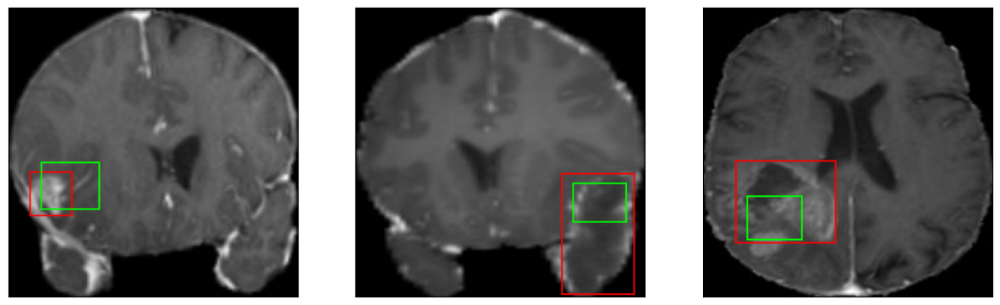

50/50 [==============================] - 9s 190ms/step - loss: 11.3072 - IoU: 0.3183 - val_loss: 15.1171 - val_IoU: 0.1974
Epoch 17/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


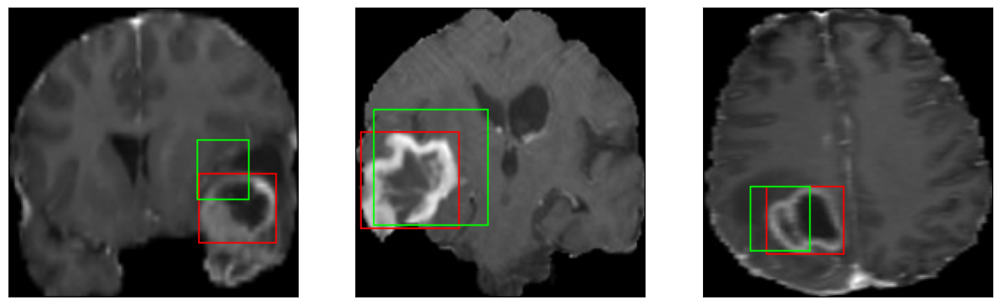

50/50 [==============================] - 10s 193ms/step - loss: 10.7737 - IoU: 0.3267 - val_loss: 12.0577 - val_IoU: 0.2937
Epoch 18/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4


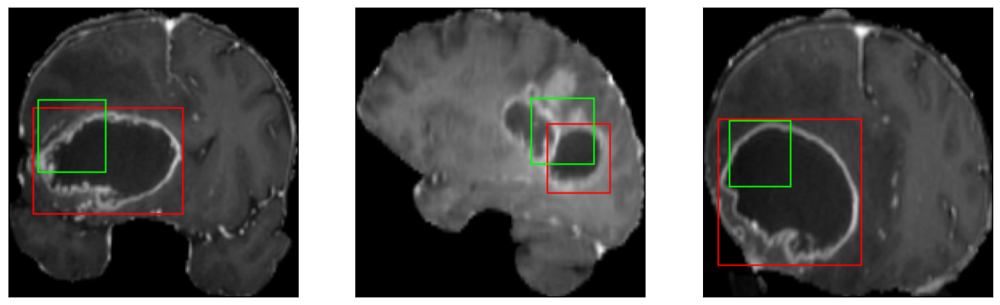

50/50 [==============================] - 10s 201ms/step - loss: 10.9766 - IoU: 0.3251 - val_loss: 11.6845 - val_IoU: 0.2999
Epoch 19/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


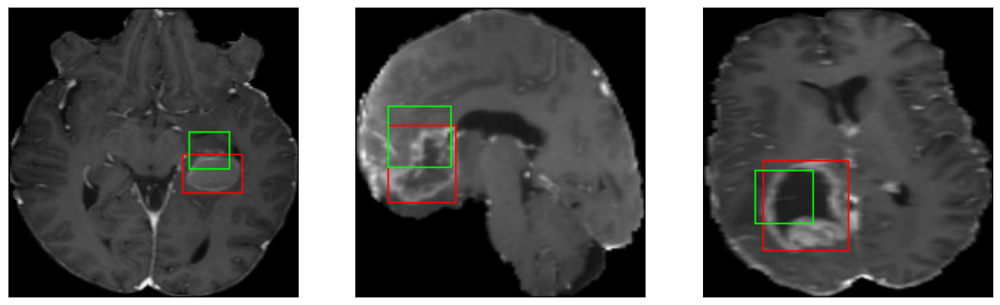

50/50 [==============================] - 10s 193ms/step - loss: 9.6943 - IoU: 0.3654 - val_loss: 12.7573 - val_IoU: 0.2540
Epoch 20/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


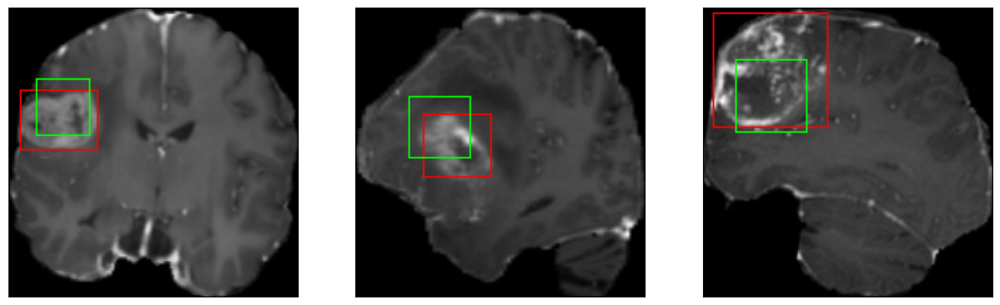

50/50 [==============================] - 10s 192ms/step - loss: 9.7218 - IoU: 0.3698 - val_loss: 12.1850 - val_IoU: 0.2697
Epoch 21/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4


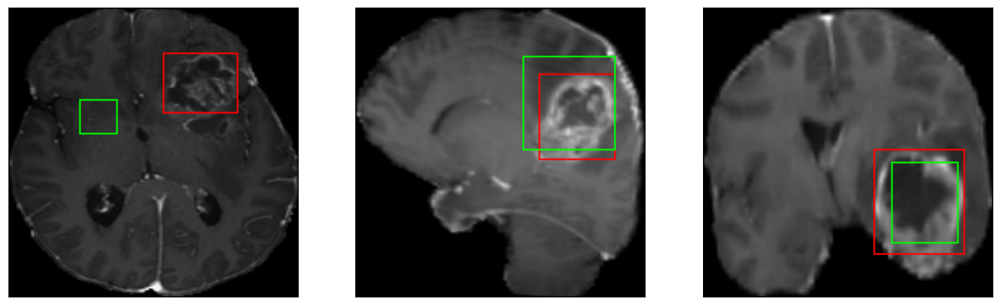

50/50 [==============================] - 10s 199ms/step - loss: 10.0492 - IoU: 0.3503 - val_loss: 9.5336 - val_IoU: 0.3872
Epoch 22/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


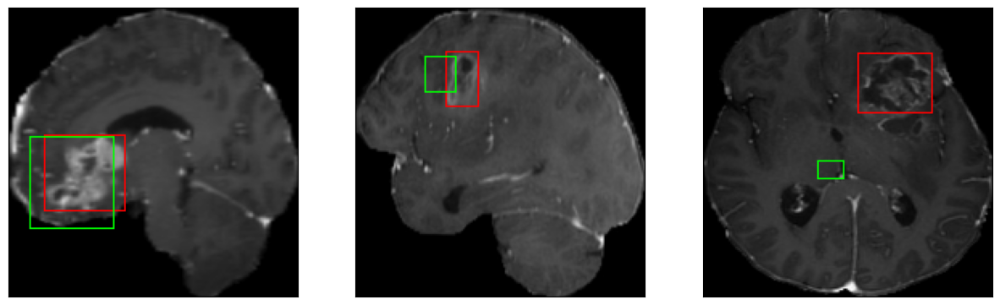

50/50 [==============================] - 10s 192ms/step - loss: 9.6337 - IoU: 0.3719 - val_loss: 11.6296 - val_IoU: 0.2978
Epoch 23/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


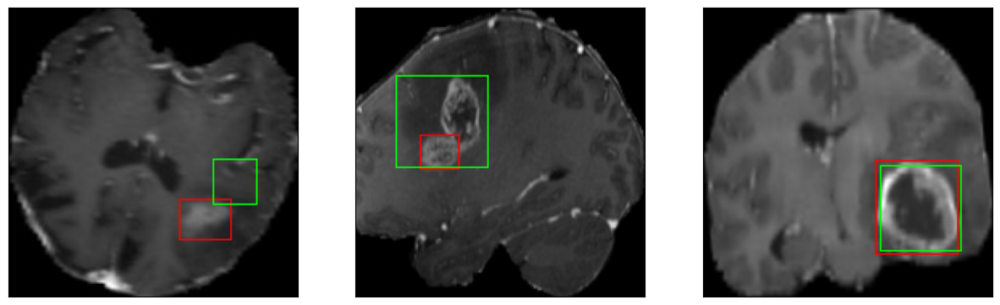

50/50 [==============================] - 10s 193ms/step - loss: 9.6875 - IoU: 0.3720 - val_loss: 9.2298 - val_IoU: 0.4395
Epoch 24/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 41ms/step
4


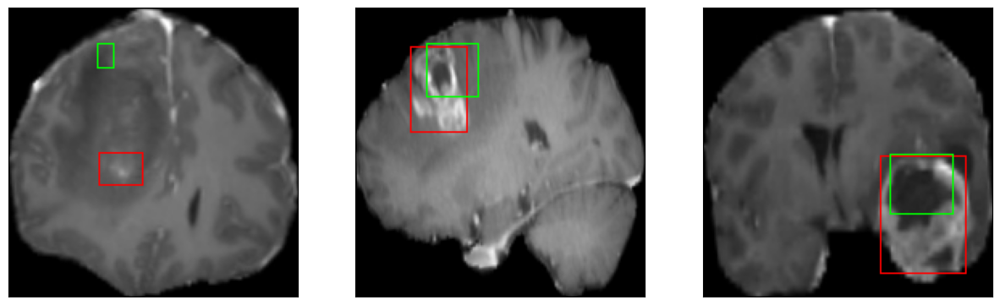

50/50 [==============================] - 10s 194ms/step - loss: 9.1686 - IoU: 0.3852 - val_loss: 15.3972 - val_IoU: 0.2108
Epoch 25/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 43ms/step
4


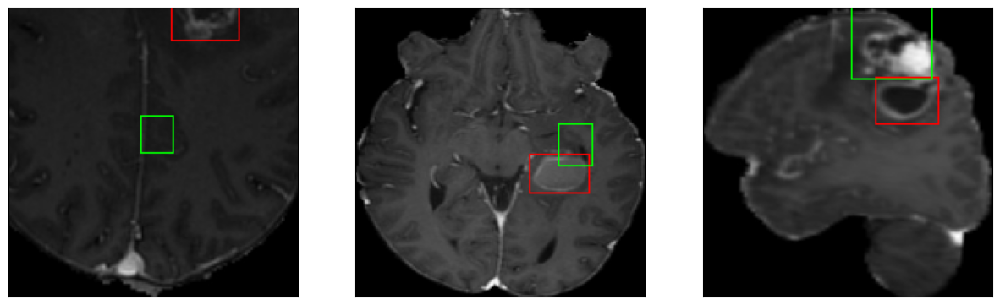

50/50 [==============================] - 10s 202ms/step - loss: 9.2695 - IoU: 0.3842 - val_loss: 9.3467 - val_IoU: 0.4196
Epoch 26/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


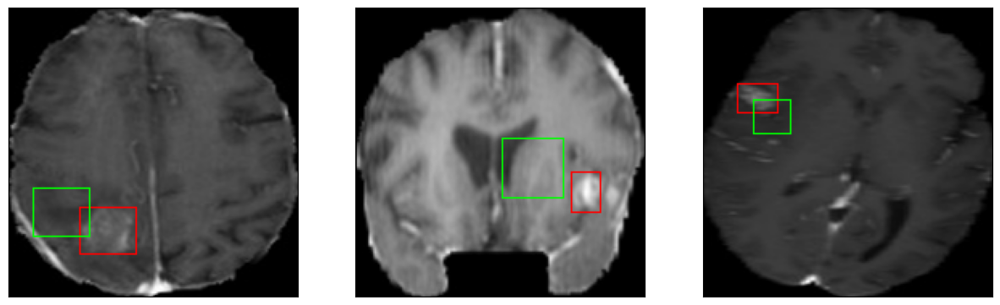

50/50 [==============================] - 10s 193ms/step - loss: 9.1648 - IoU: 0.3752 - val_loss: 11.3254 - val_IoU: 0.2782
Epoch 27/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 39ms/step
4


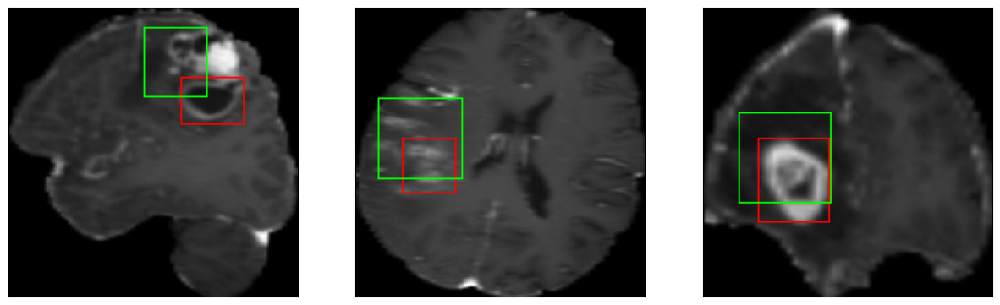

50/50 [==============================] - 10s 194ms/step - loss: 8.4412 - IoU: 0.4110 - val_loss: 9.3391 - val_IoU: 0.3907
Epoch 28/100
7/7 [==============================] - 0s 44ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 42ms/step
4


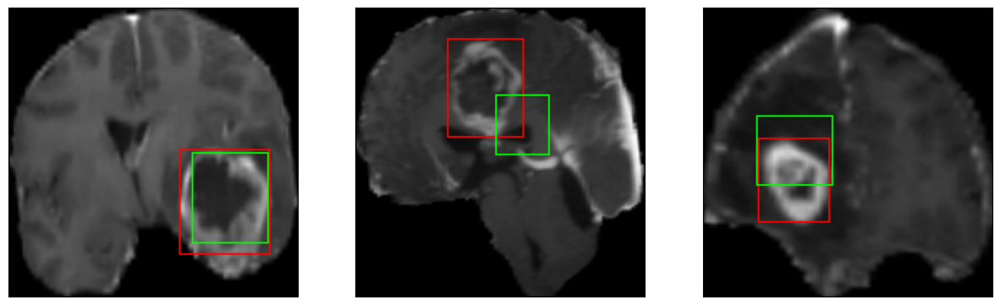

50/50 [==============================] - 10s 197ms/step - loss: 8.2069 - IoU: 0.4184 - val_loss: 9.2201 - val_IoU: 0.3888
Epoch 29/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


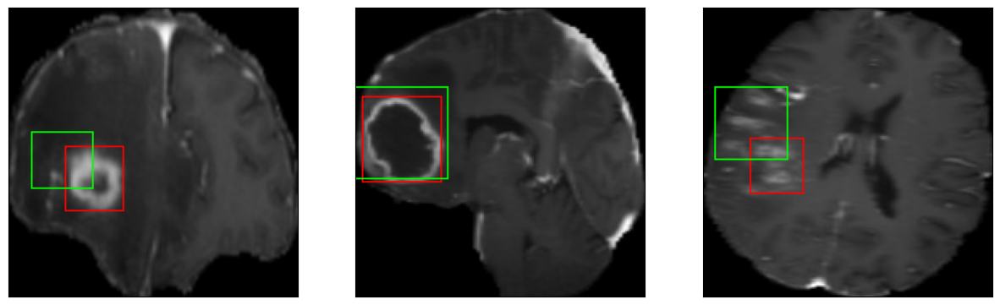

50/50 [==============================] - 10s 192ms/step - loss: 8.6938 - IoU: 0.3949 - val_loss: 8.7621 - val_IoU: 0.4310
Epoch 30/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


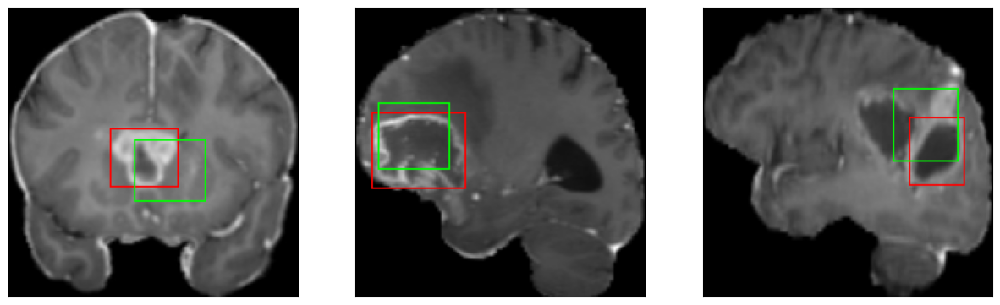

50/50 [==============================] - 10s 194ms/step - loss: 8.6020 - IoU: 0.4088 - val_loss: 9.6505 - val_IoU: 0.3814
Epoch 31/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 42ms/step
4


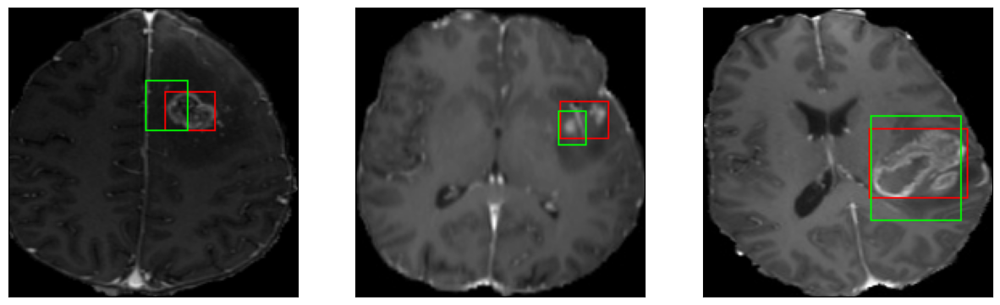

50/50 [==============================] - 10s 200ms/step - loss: 7.8160 - IoU: 0.4285 - val_loss: 8.9336 - val_IoU: 0.4067
Epoch 32/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4


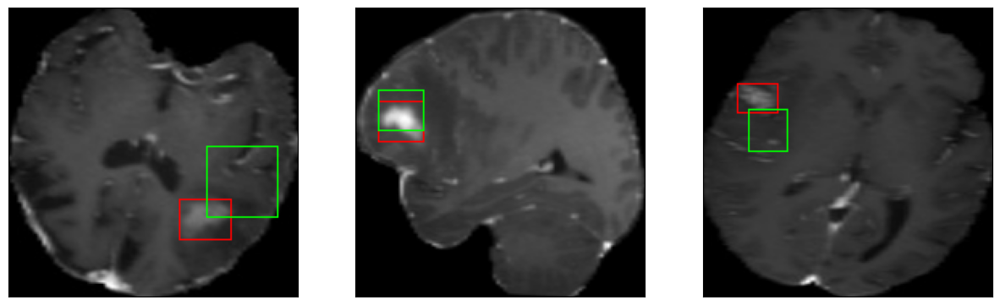

50/50 [==============================] - 10s 192ms/step - loss: 8.2025 - IoU: 0.4181 - val_loss: 9.5253 - val_IoU: 0.3945
Epoch 33/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


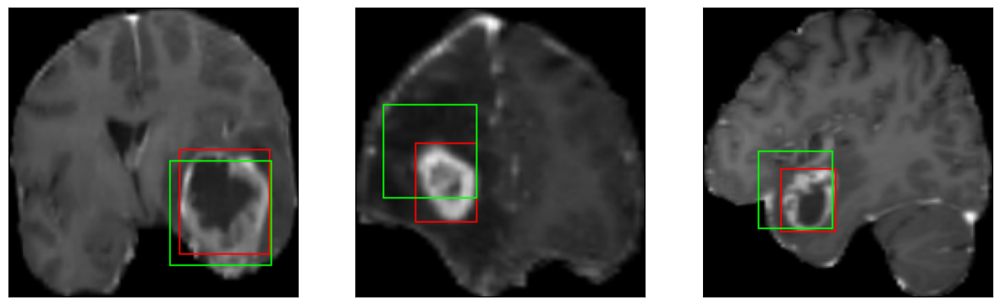

50/50 [==============================] - 10s 193ms/step - loss: 8.2681 - IoU: 0.4119 - val_loss: 9.6055 - val_IoU: 0.3937
Epoch 34/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


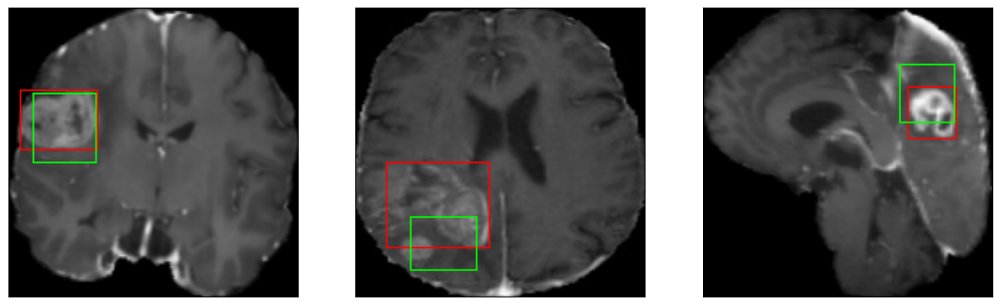

50/50 [==============================] - 10s 194ms/step - loss: 8.0023 - IoU: 0.4253 - val_loss: 8.6500 - val_IoU: 0.4132
Epoch 35/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4


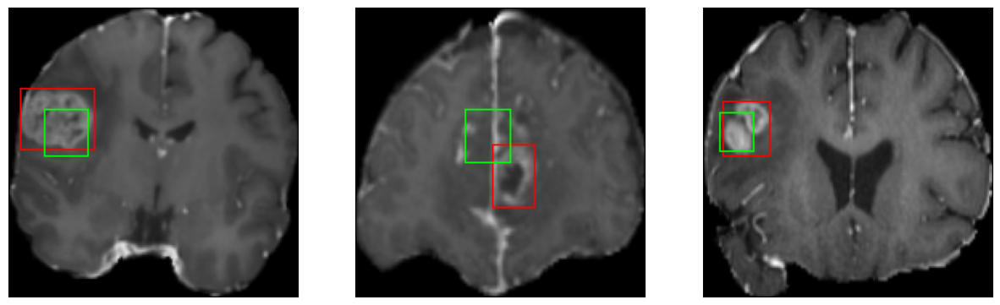

50/50 [==============================] - 10s 194ms/step - loss: 7.4692 - IoU: 0.4520 - val_loss: 9.9306 - val_IoU: 0.3492
Epoch 36/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


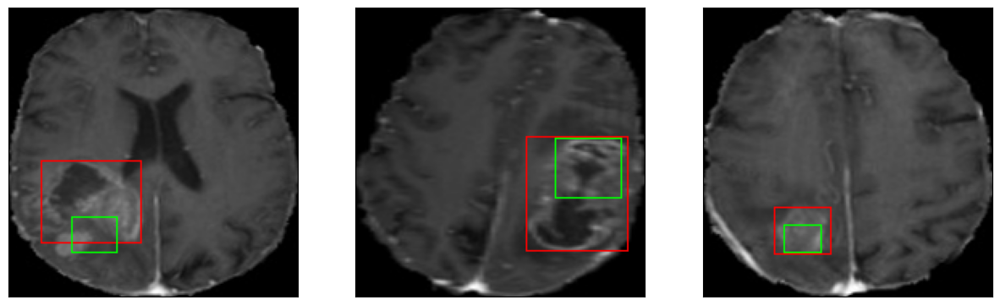

50/50 [==============================] - 10s 195ms/step - loss: 7.4399 - IoU: 0.4530 - val_loss: 10.2099 - val_IoU: 0.3631
Epoch 37/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4


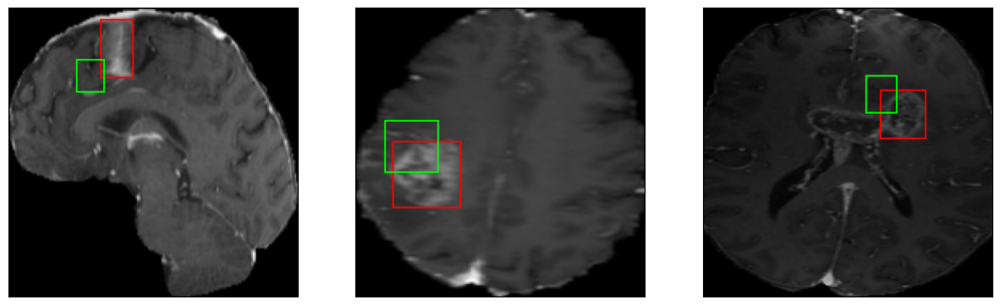

50/50 [==============================] - 10s 199ms/step - loss: 7.1553 - IoU: 0.4608 - val_loss: 9.8596 - val_IoU: 0.3804
Epoch 38/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


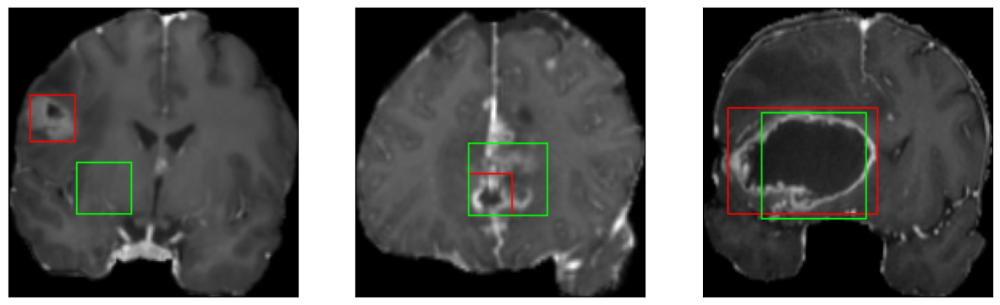

50/50 [==============================] - 10s 202ms/step - loss: 7.3227 - IoU: 0.4495 - val_loss: 9.1377 - val_IoU: 0.4219
Epoch 39/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


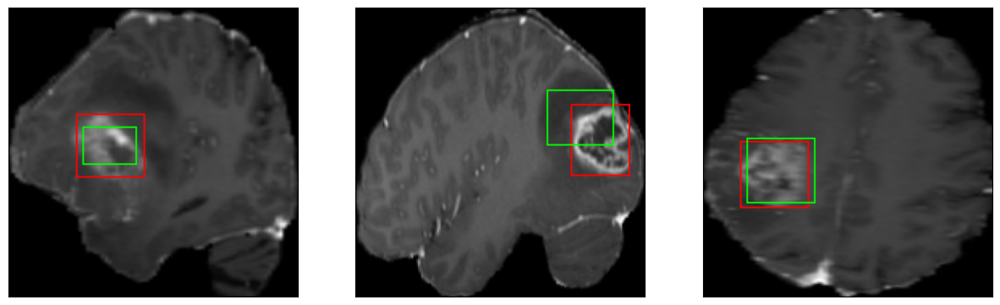

50/50 [==============================] - 10s 195ms/step - loss: 7.1387 - IoU: 0.4640 - val_loss: 8.5868 - val_IoU: 0.4415
Epoch 40/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


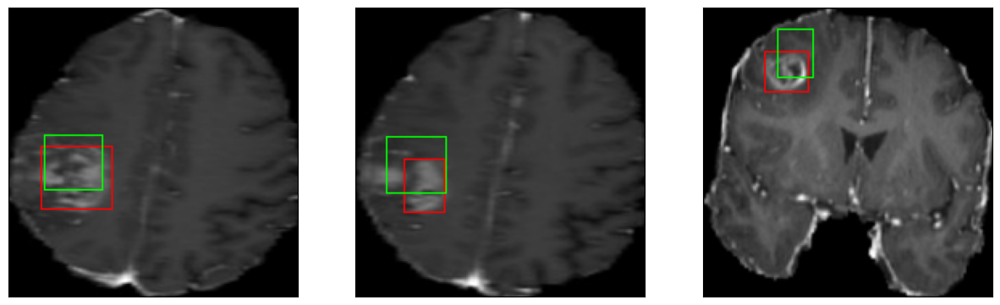

50/50 [==============================] - 10s 198ms/step - loss: 7.1056 - IoU: 0.4653 - val_loss: 9.8377 - val_IoU: 0.3167
Epoch 41/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


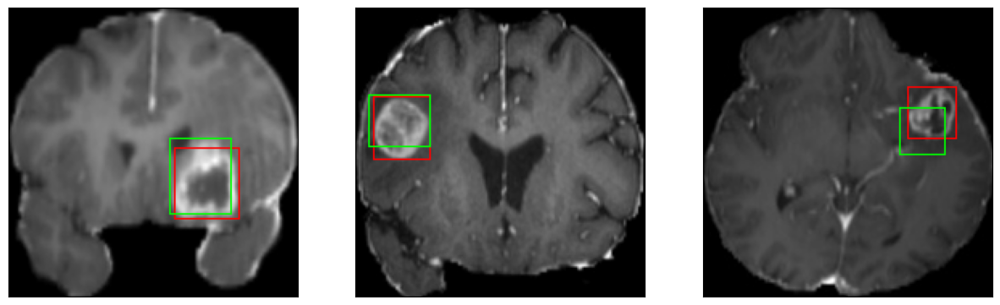

50/50 [==============================] - 10s 194ms/step - loss: 7.0137 - IoU: 0.4706 - val_loss: 8.2444 - val_IoU: 0.4436
Epoch 42/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


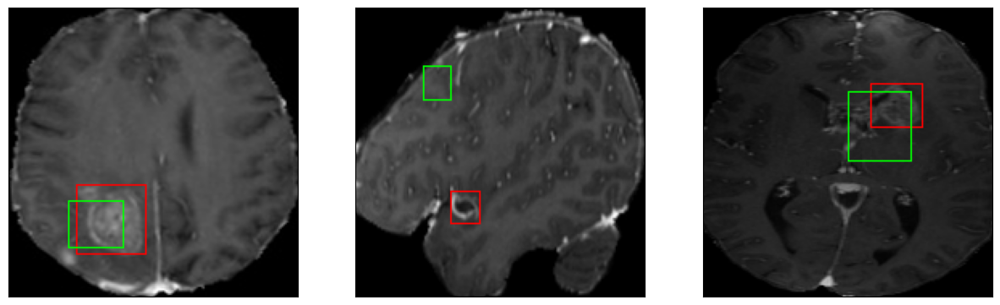

50/50 [==============================] - 10s 195ms/step - loss: 7.0564 - IoU: 0.4689 - val_loss: 8.3077 - val_IoU: 0.4147
Epoch 43/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


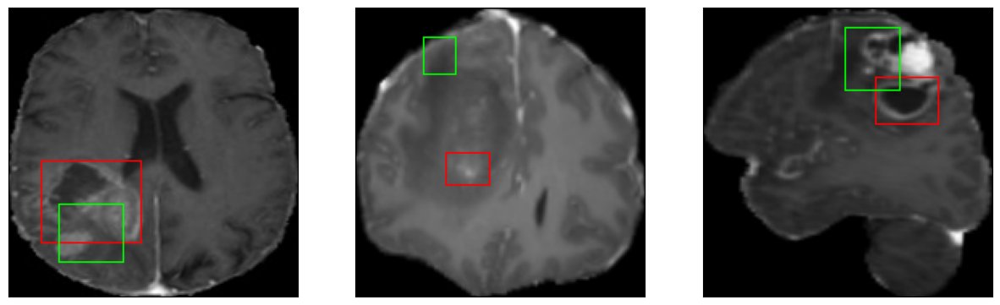

50/50 [==============================] - 10s 199ms/step - loss: 7.1508 - IoU: 0.4573 - val_loss: 8.4542 - val_IoU: 0.4230
Epoch 44/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


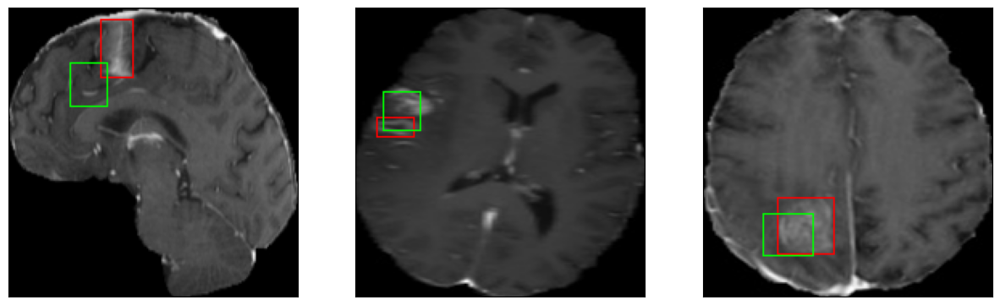

50/50 [==============================] - 10s 194ms/step - loss: 6.9762 - IoU: 0.4706 - val_loss: 8.3249 - val_IoU: 0.4031
Epoch 45/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


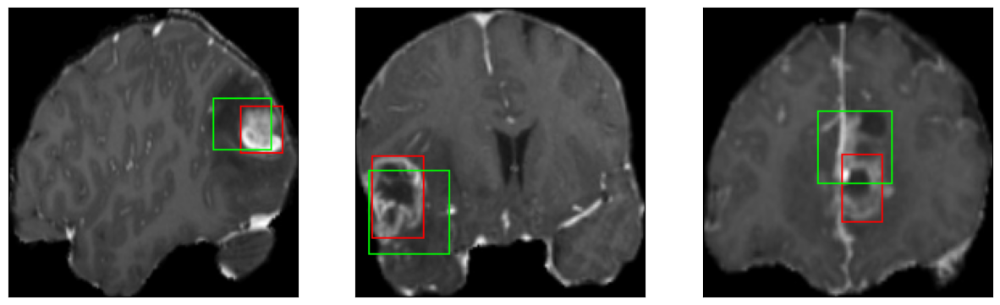

50/50 [==============================] - 10s 195ms/step - loss: 6.8083 - IoU: 0.4794 - val_loss: 7.9932 - val_IoU: 0.4490
Epoch 46/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4


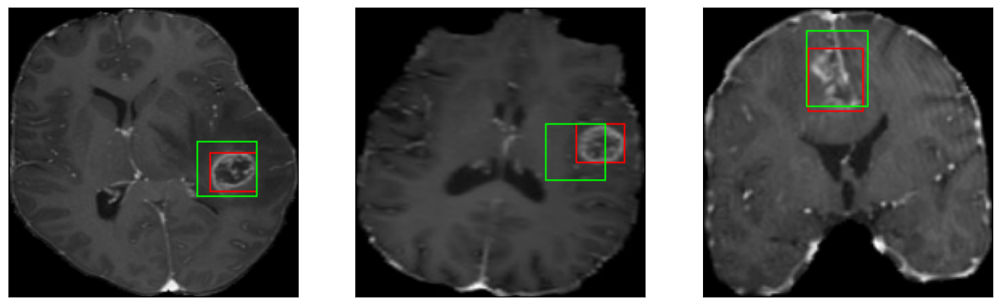

50/50 [==============================] - 10s 199ms/step - loss: 6.8212 - IoU: 0.4827 - val_loss: 8.2623 - val_IoU: 0.4989
Epoch 47/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


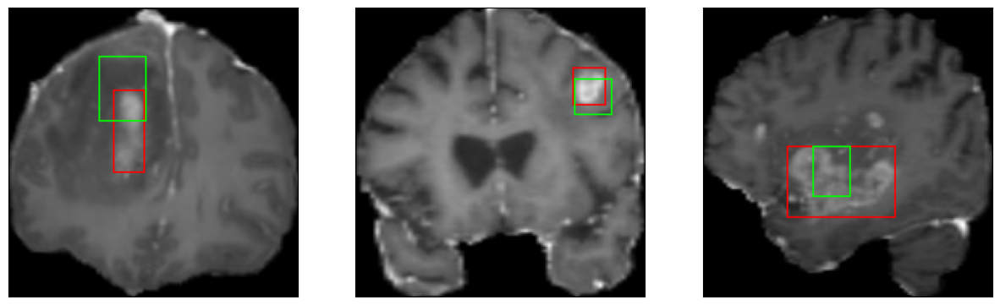

50/50 [==============================] - 10s 194ms/step - loss: 7.1087 - IoU: 0.4679 - val_loss: 9.1416 - val_IoU: 0.4006
Epoch 48/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


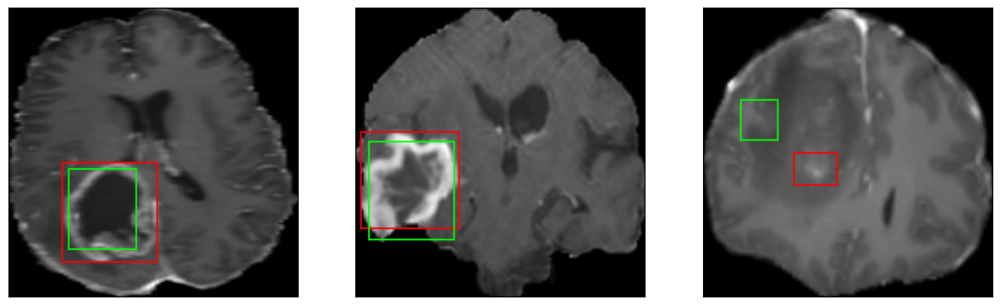

50/50 [==============================] - 10s 197ms/step - loss: 6.4385 - IoU: 0.5022 - val_loss: 7.7657 - val_IoU: 0.4570
Epoch 49/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 41ms/step
4


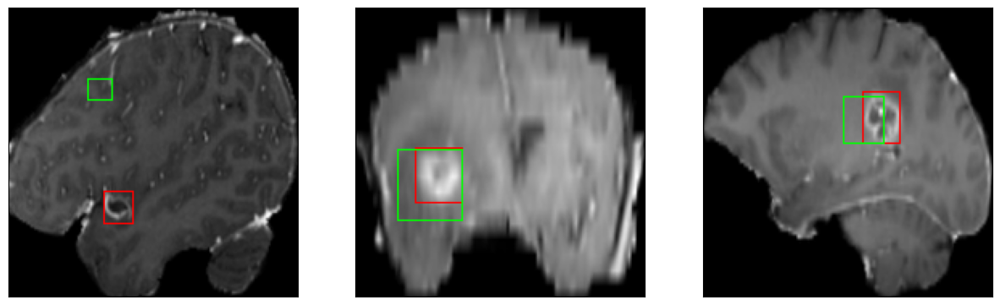

50/50 [==============================] - 10s 198ms/step - loss: 6.6024 - IoU: 0.4881 - val_loss: 8.1642 - val_IoU: 0.4414
Epoch 50/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4


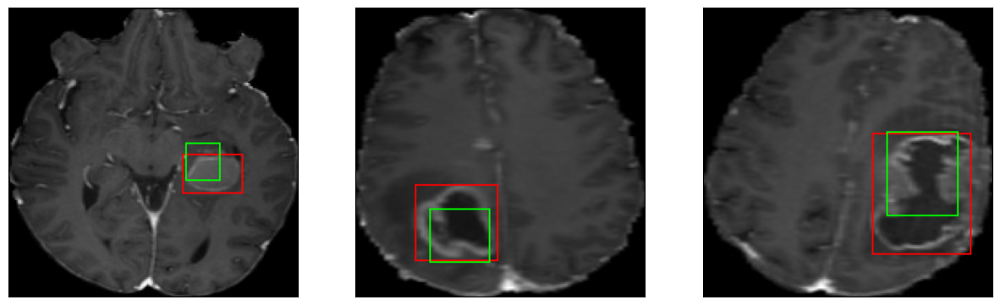

50/50 [==============================] - 10s 196ms/step - loss: 6.3205 - IoU: 0.4985 - val_loss: 7.6596 - val_IoU: 0.4665
Epoch 51/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4


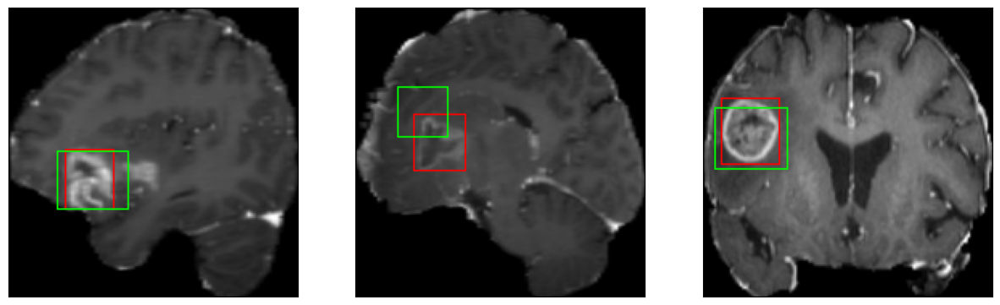

50/50 [==============================] - 10s 197ms/step - loss: 6.6548 - IoU: 0.4865 - val_loss: 8.9820 - val_IoU: 0.4175
Epoch 52/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


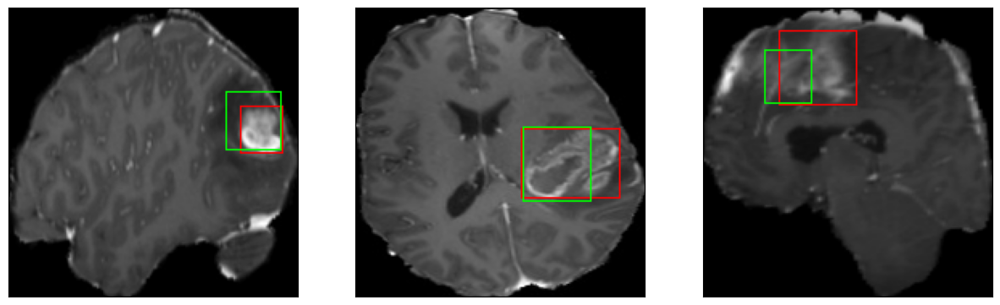

50/50 [==============================] - 10s 200ms/step - loss: 6.8076 - IoU: 0.4781 - val_loss: 8.4995 - val_IoU: 0.4138
Epoch 53/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


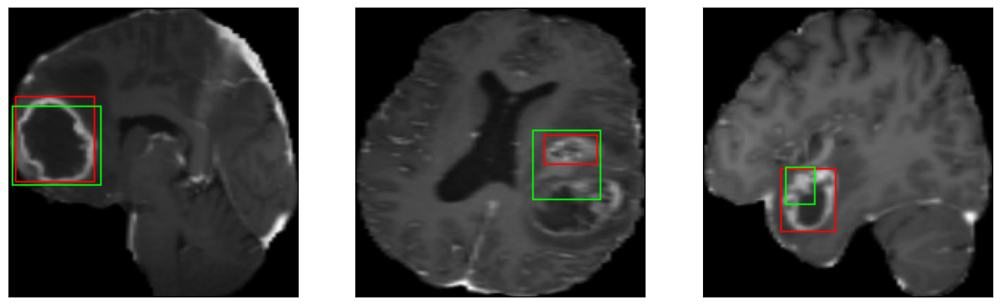

50/50 [==============================] - 10s 196ms/step - loss: 6.3757 - IoU: 0.5023 - val_loss: 8.7137 - val_IoU: 0.4191
Epoch 54/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


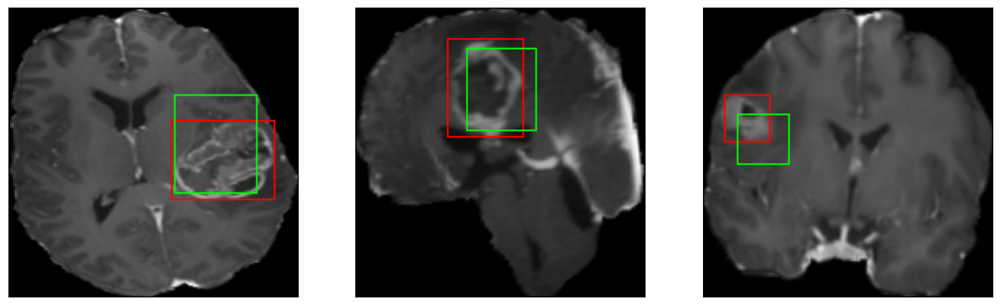

50/50 [==============================] - 10s 198ms/step - loss: 6.3597 - IoU: 0.5015 - val_loss: 9.2742 - val_IoU: 0.3670
Epoch 55/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4


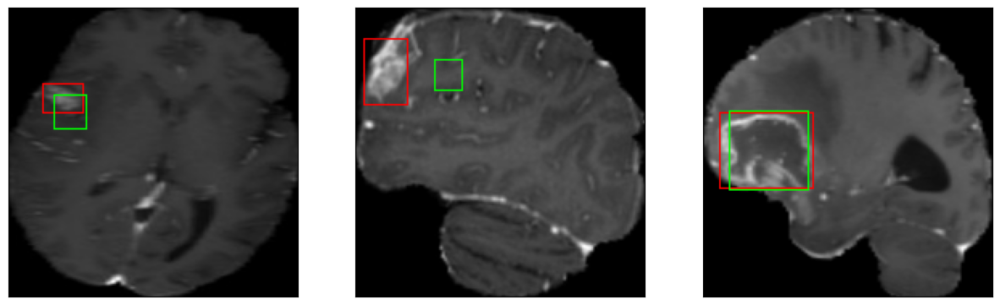

50/50 [==============================] - 10s 202ms/step - loss: 6.4347 - IoU: 0.4977 - val_loss: 8.3459 - val_IoU: 0.4102
Epoch 56/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


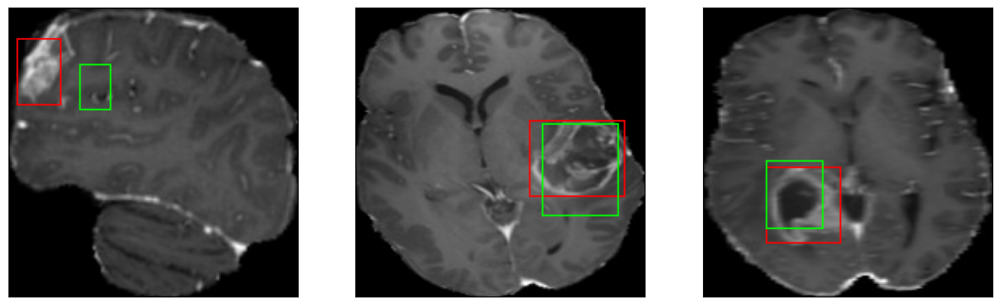

50/50 [==============================] - 10s 196ms/step - loss: 6.2232 - IoU: 0.5130 - val_loss: 7.4604 - val_IoU: 0.5069
Epoch 57/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 41ms/step
4


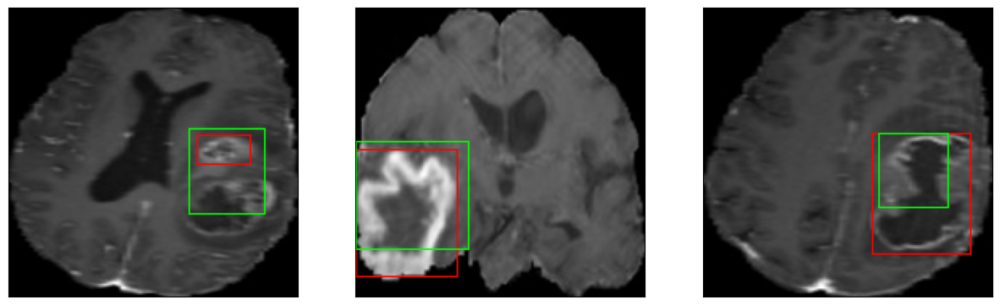

50/50 [==============================] - 10s 195ms/step - loss: 6.5904 - IoU: 0.4938 - val_loss: 7.8764 - val_IoU: 0.4528
Epoch 58/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 42ms/step
4


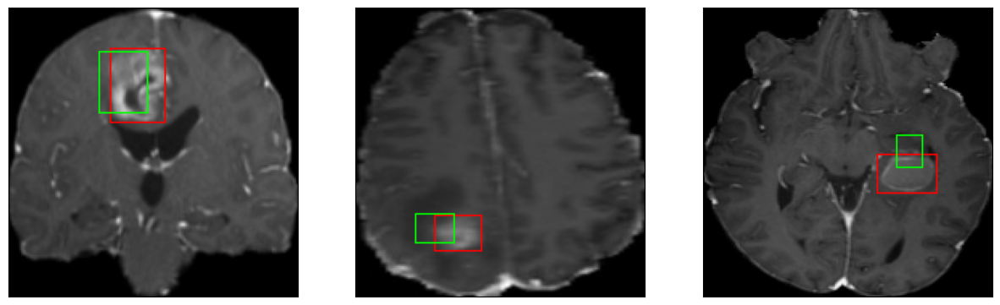

50/50 [==============================] - 10s 209ms/step - loss: 6.1104 - IoU: 0.5207 - val_loss: 9.0649 - val_IoU: 0.3809
Epoch 59/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


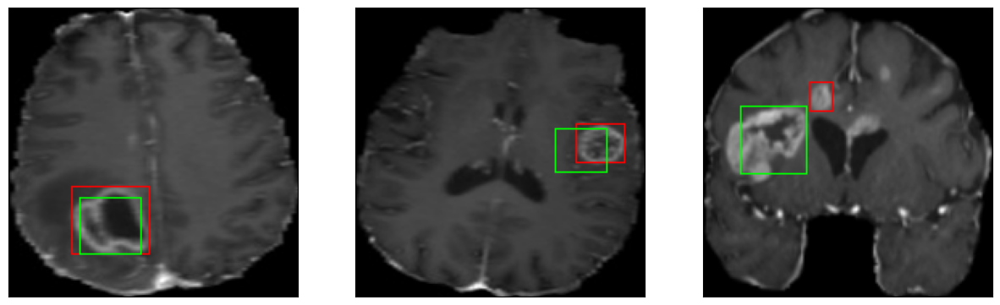

50/50 [==============================] - 10s 195ms/step - loss: 6.2795 - IoU: 0.5107 - val_loss: 7.5474 - val_IoU: 0.4650
Epoch 60/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4


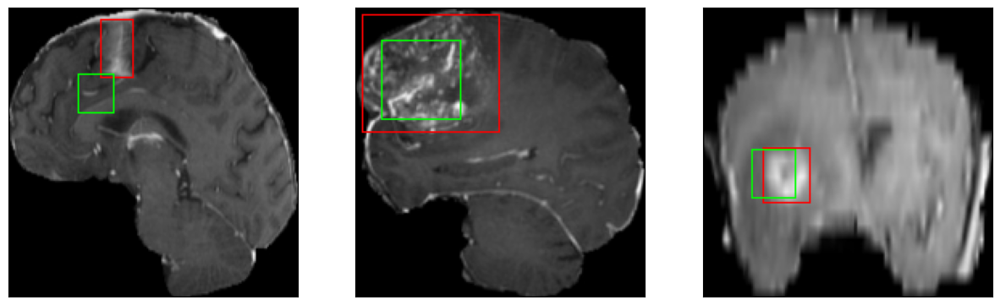

50/50 [==============================] - 10s 199ms/step - loss: 6.4112 - IoU: 0.5006 - val_loss: 7.8468 - val_IoU: 0.4548
Epoch 61/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


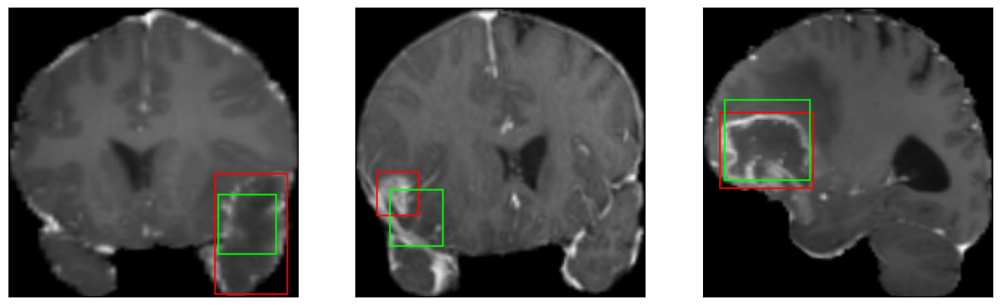

50/50 [==============================] - 10s 197ms/step - loss: 5.9414 - IoU: 0.5171 - val_loss: 7.8733 - val_IoU: 0.4539
Epoch 62/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


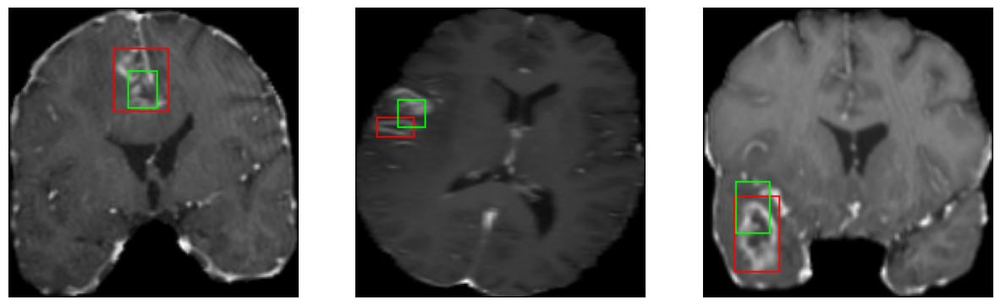

50/50 [==============================] - 10s 197ms/step - loss: 6.4470 - IoU: 0.5013 - val_loss: 9.1279 - val_IoU: 0.3663
Epoch 63/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 43ms/step
4


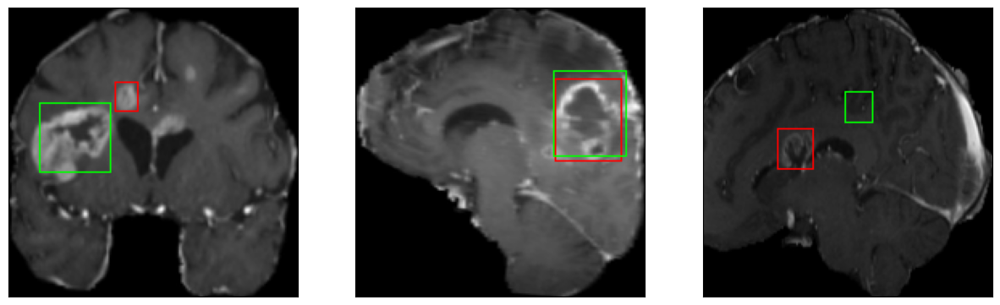

50/50 [==============================] - 11s 214ms/step - loss: 6.0168 - IoU: 0.5186 - val_loss: 8.0034 - val_IoU: 0.4307
Epoch 64/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


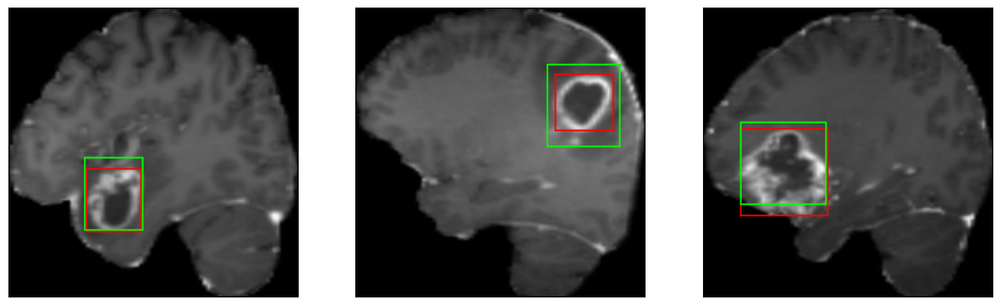

50/50 [==============================] - 10s 197ms/step - loss: 5.5429 - IoU: 0.5428 - val_loss: 7.4518 - val_IoU: 0.4781
Epoch 65/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


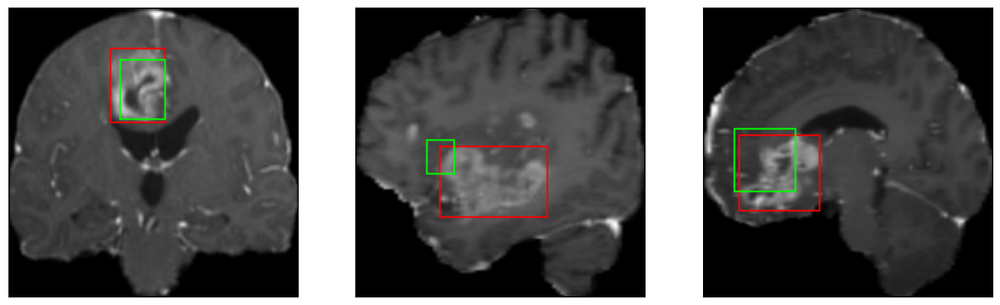

50/50 [==============================] - 10s 198ms/step - loss: 5.9960 - IoU: 0.5281 - val_loss: 8.8078 - val_IoU: 0.3836
Epoch 66/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 42ms/step
4


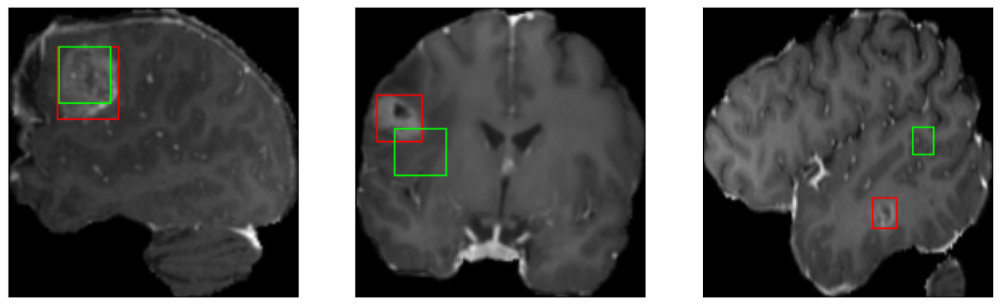

50/50 [==============================] - 10s 210ms/step - loss: 6.1005 - IoU: 0.5204 - val_loss: 9.8425 - val_IoU: 0.3399
Epoch 67/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


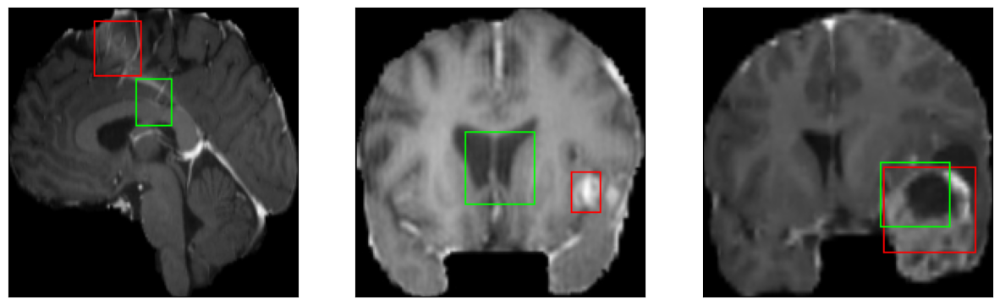

50/50 [==============================] - 10s 195ms/step - loss: 5.9763 - IoU: 0.5198 - val_loss: 8.9852 - val_IoU: 0.3721
Epoch 68/100
7/7 [==============================] - 0s 49ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4


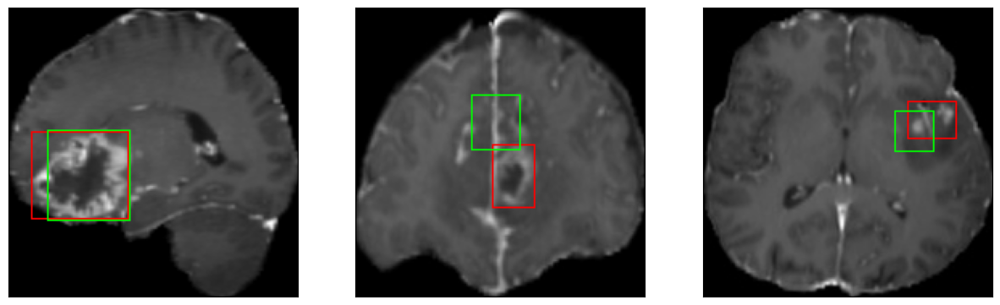

50/50 [==============================] - 11s 225ms/step - loss: 5.6806 - IoU: 0.5354 - val_loss: 7.7153 - val_IoU: 0.4540
Epoch 69/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


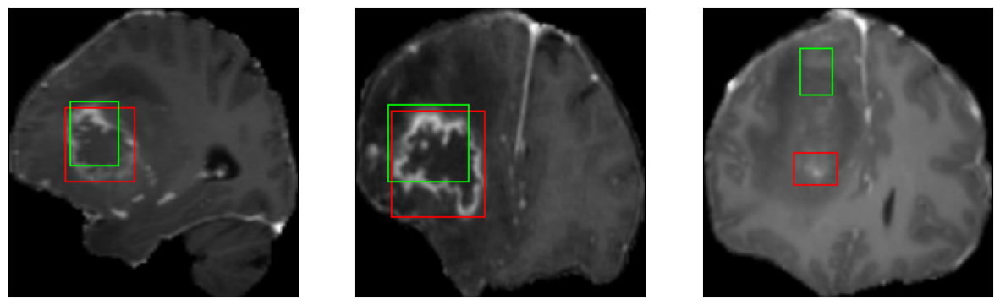

50/50 [==============================] - 10s 198ms/step - loss: 5.5080 - IoU: 0.5551 - val_loss: 8.0307 - val_IoU: 0.4515
Epoch 70/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


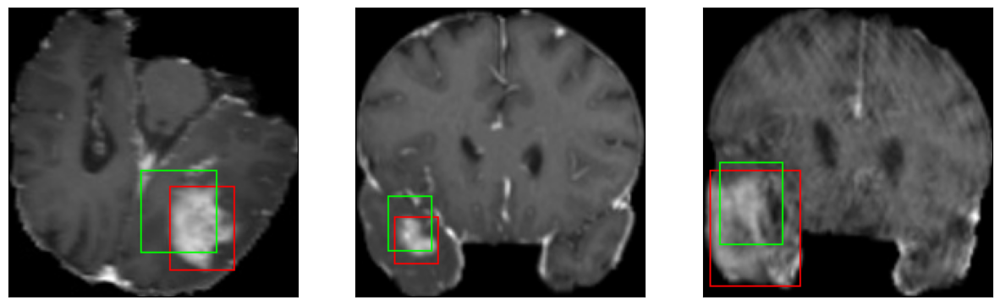

50/50 [==============================] - 10s 195ms/step - loss: 5.7588 - IoU: 0.5357 - val_loss: 7.8005 - val_IoU: 0.4570
Epoch 71/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4


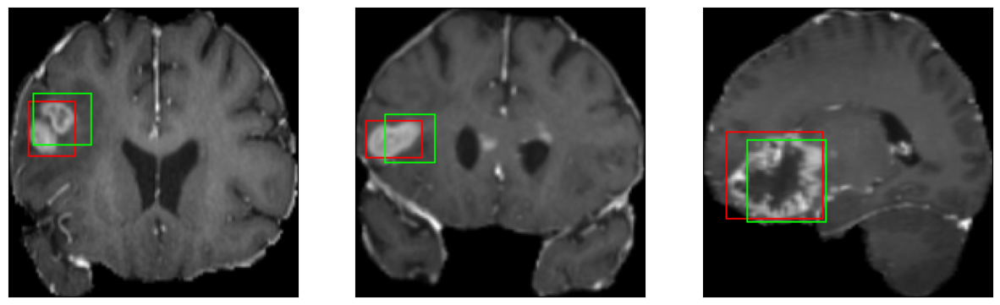

50/50 [==============================] - 10s 202ms/step - loss: 5.7857 - IoU: 0.5338 - val_loss: 7.5603 - val_IoU: 0.4756
Epoch 72/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


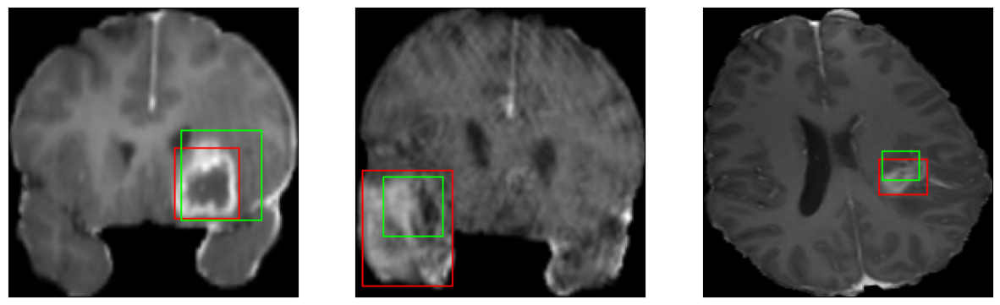

50/50 [==============================] - 10s 196ms/step - loss: 5.3814 - IoU: 0.5555 - val_loss: 8.2279 - val_IoU: 0.4342
Epoch 73/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


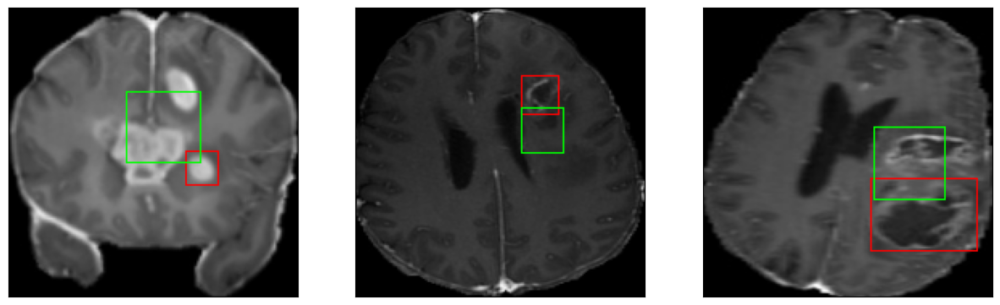

50/50 [==============================] - 10s 194ms/step - loss: 5.5290 - IoU: 0.5459 - val_loss: 8.1386 - val_IoU: 0.4370
Epoch 74/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4


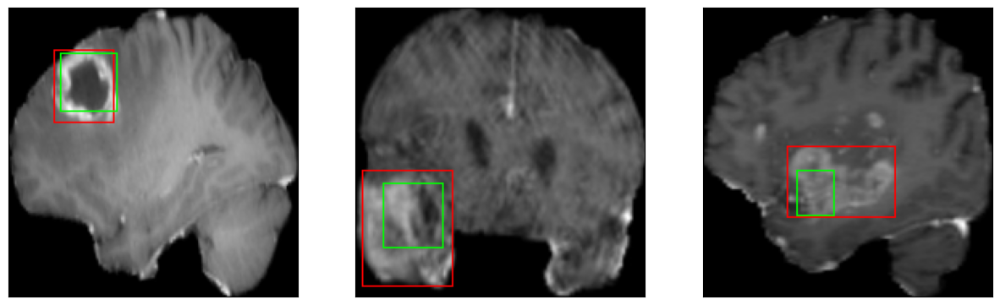

50/50 [==============================] - 10s 206ms/step - loss: 5.2403 - IoU: 0.5666 - val_loss: 6.7461 - val_IoU: 0.5241
Epoch 75/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


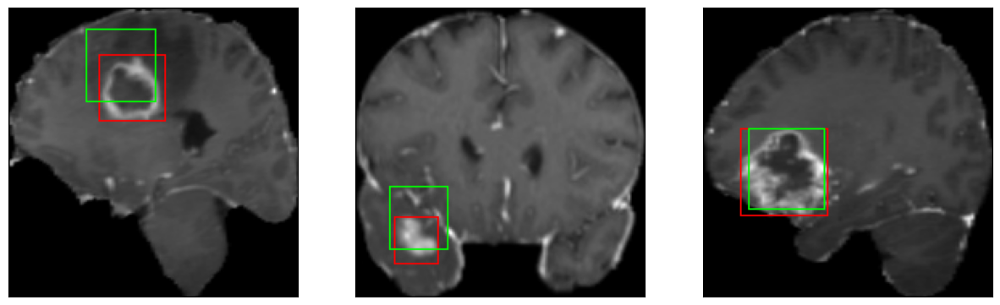

50/50 [==============================] - 10s 192ms/step - loss: 5.5615 - IoU: 0.5423 - val_loss: 8.1166 - val_IoU: 0.4206
Epoch 76/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 42ms/step
4


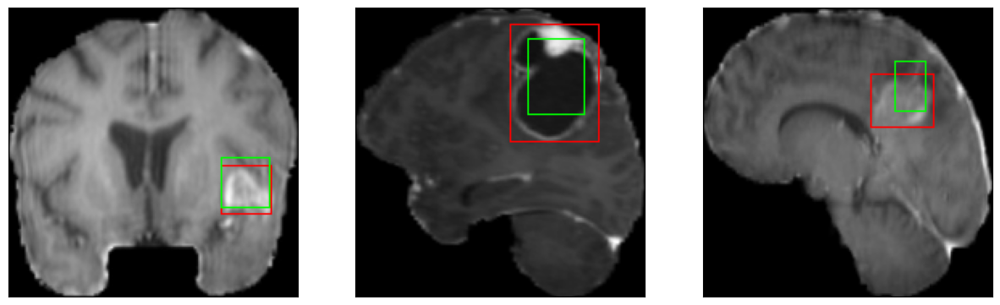

50/50 [==============================] - 10s 199ms/step - loss: 5.7483 - IoU: 0.5420 - val_loss: 8.2091 - val_IoU: 0.4342
Epoch 77/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


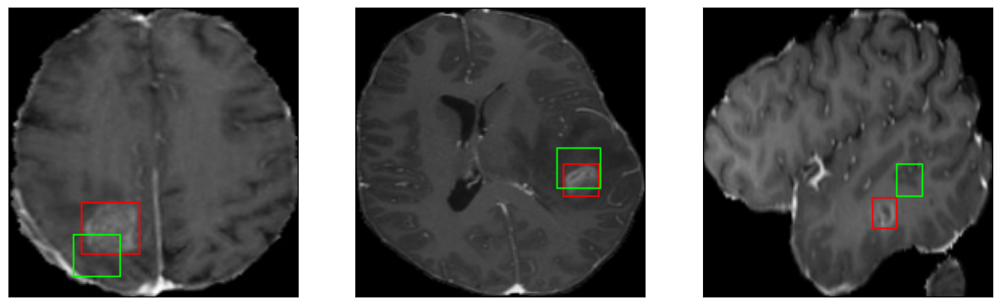

50/50 [==============================] - 10s 197ms/step - loss: 5.5925 - IoU: 0.5439 - val_loss: 7.9413 - val_IoU: 0.4624
Epoch 78/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 50ms/step
4


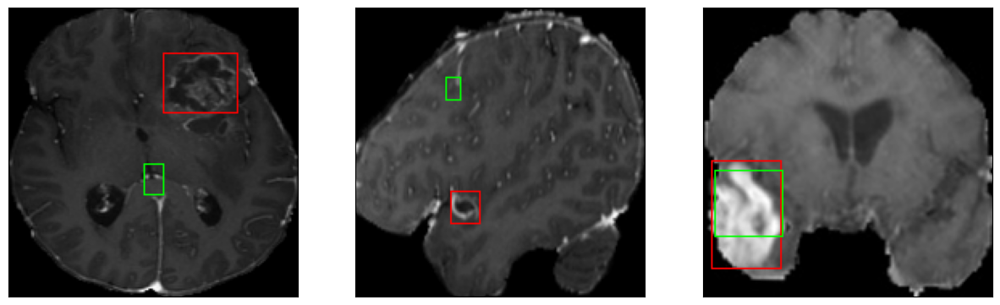

50/50 [==============================] - 10s 205ms/step - loss: 5.6126 - IoU: 0.5440 - val_loss: 7.6756 - val_IoU: 0.4595
Epoch 79/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 42ms/step
4


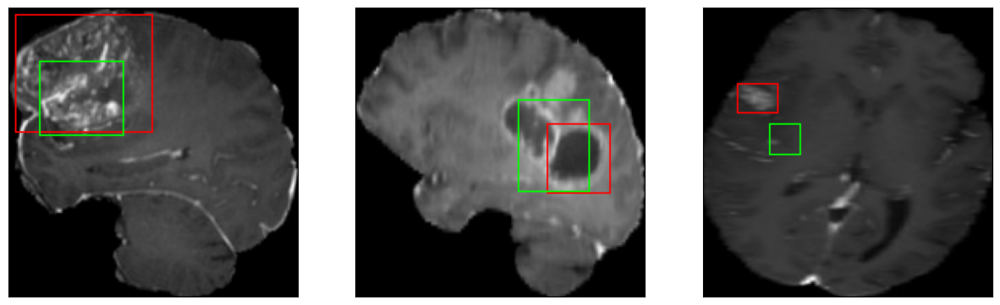

50/50 [==============================] - 10s 206ms/step - loss: 5.4126 - IoU: 0.5532 - val_loss: 7.6147 - val_IoU: 0.4876
Epoch 80/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


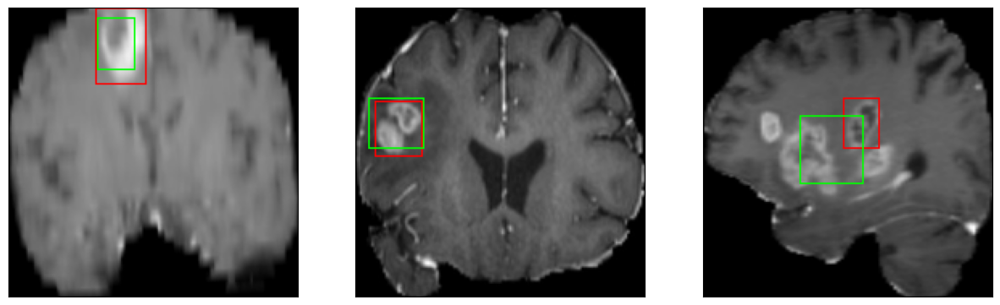

50/50 [==============================] - 10s 197ms/step - loss: 5.8045 - IoU: 0.5349 - val_loss: 7.2767 - val_IoU: 0.4817
Epoch 81/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


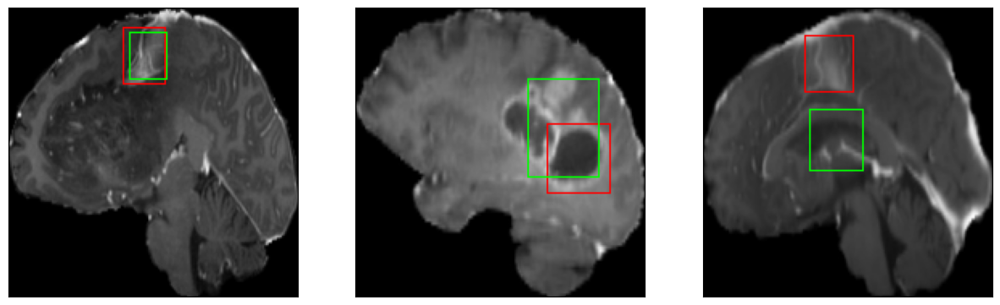

50/50 [==============================] - 10s 196ms/step - loss: 5.5484 - IoU: 0.5545 - val_loss: 7.8586 - val_IoU: 0.4396
Epoch 82/100
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 40ms/step
4


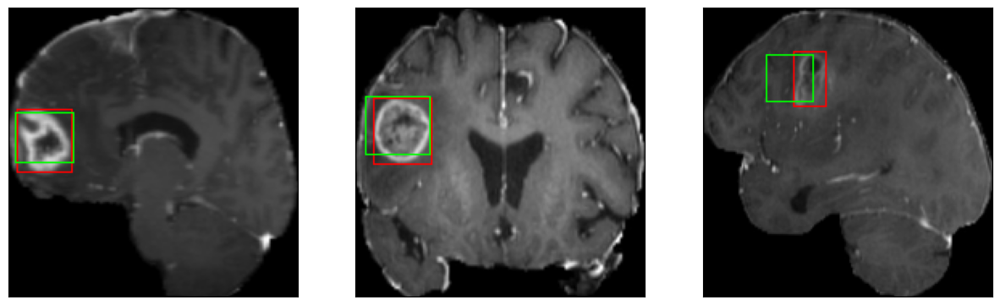

50/50 [==============================] - 10s 205ms/step - loss: 5.4040 - IoU: 0.5511 - val_loss: 7.4113 - val_IoU: 0.4699
Epoch 83/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


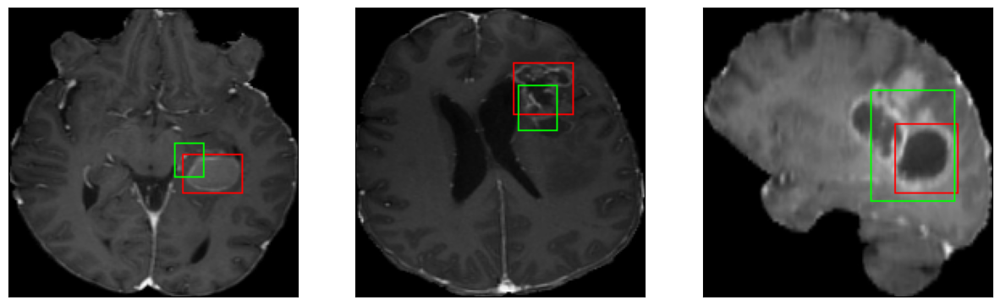

50/50 [==============================] - 10s 194ms/step - loss: 5.4847 - IoU: 0.5567 - val_loss: 7.1834 - val_IoU: 0.4633
Epoch 84/100
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 42ms/step
4


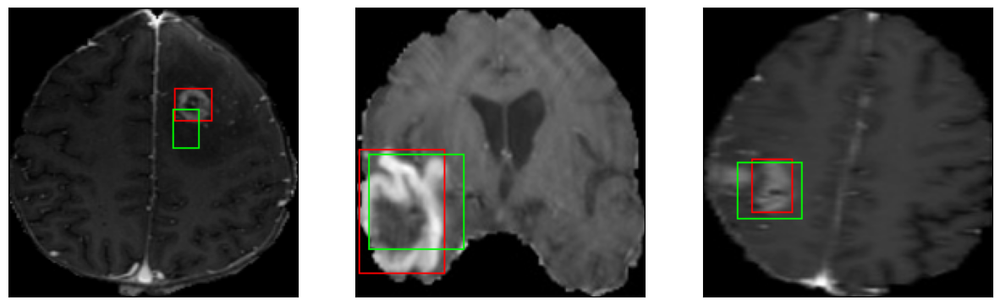

50/50 [==============================] - 10s 208ms/step - loss: 5.2674 - IoU: 0.5599 - val_loss: 7.4019 - val_IoU: 0.4622
Epoch 85/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 41ms/step
4


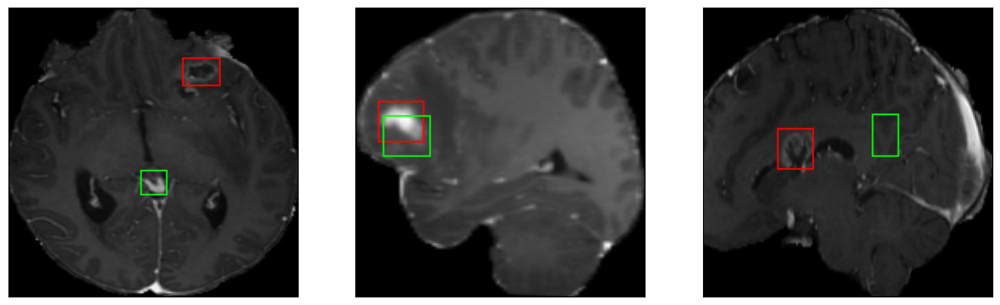

50/50 [==============================] - 10s 198ms/step - loss: 5.4518 - IoU: 0.5528 - val_loss: 8.2901 - val_IoU: 0.4325
Epoch 86/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


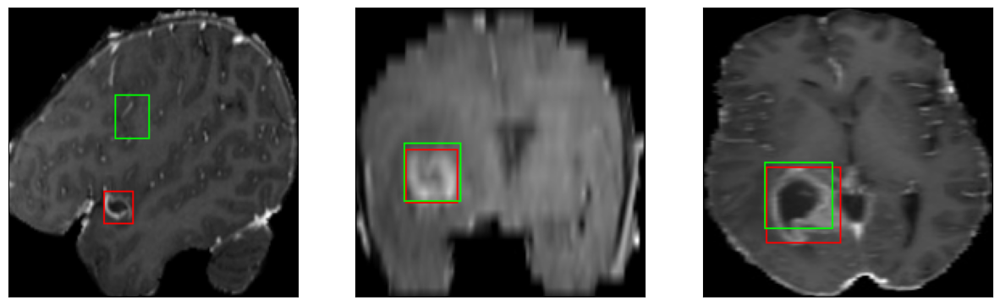

50/50 [==============================] - 10s 197ms/step - loss: 5.1559 - IoU: 0.5774 - val_loss: 7.2415 - val_IoU: 0.4824
Epoch 87/100
7/7 [==============================] - 0s 43ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4


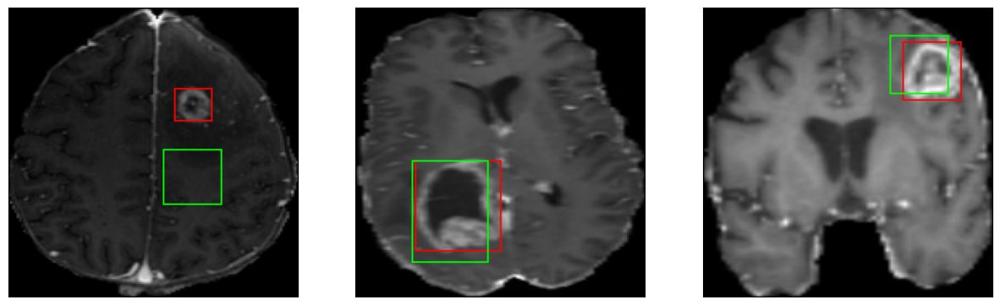

50/50 [==============================] - 10s 201ms/step - loss: 5.1860 - IoU: 0.5641 - val_loss: 7.2566 - val_IoU: 0.4707
Epoch 88/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


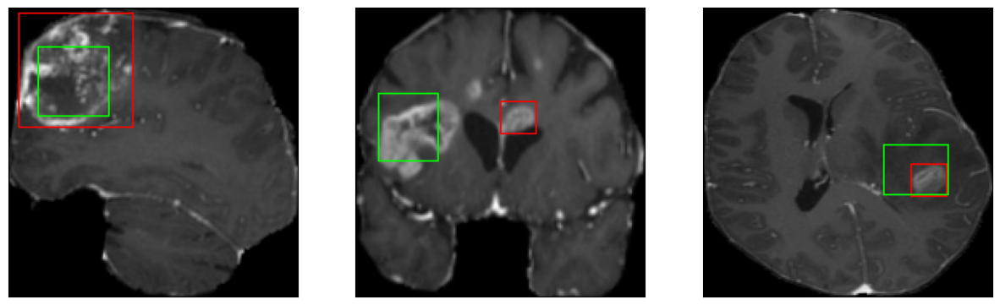

50/50 [==============================] - 10s 195ms/step - loss: 4.9955 - IoU: 0.5813 - val_loss: 7.9532 - val_IoU: 0.4081
Epoch 89/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4


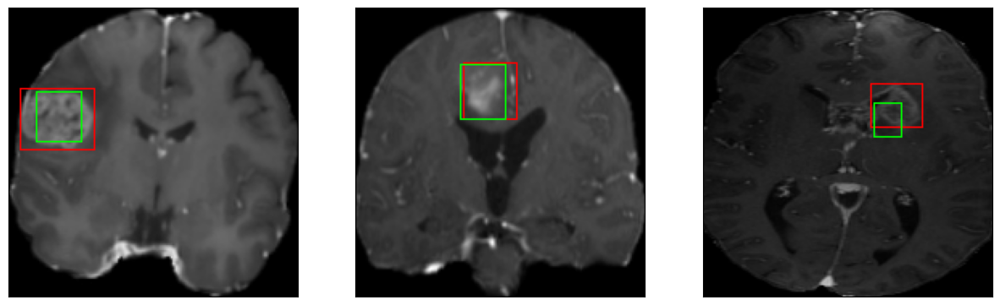

50/50 [==============================] - 10s 197ms/step - loss: 5.2958 - IoU: 0.5517 - val_loss: 8.5187 - val_IoU: 0.4148
Epoch 90/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4


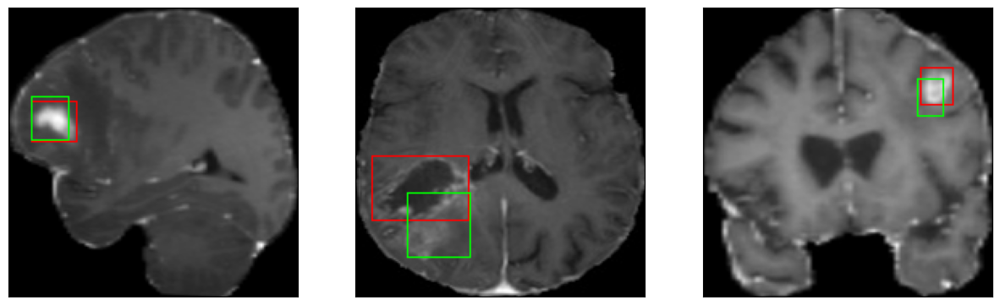

50/50 [==============================] - 10s 198ms/step - loss: 5.3618 - IoU: 0.5591 - val_loss: 6.7623 - val_IoU: 0.5006
Epoch 91/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


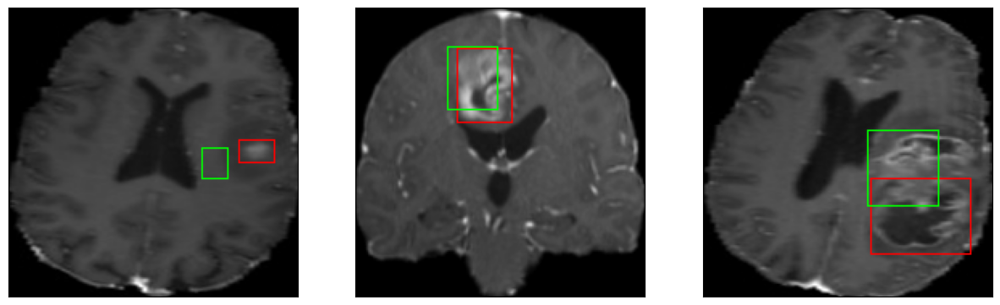

50/50 [==============================] - 10s 196ms/step - loss: 5.2048 - IoU: 0.5713 - val_loss: 8.3168 - val_IoU: 0.4206
Epoch 92/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


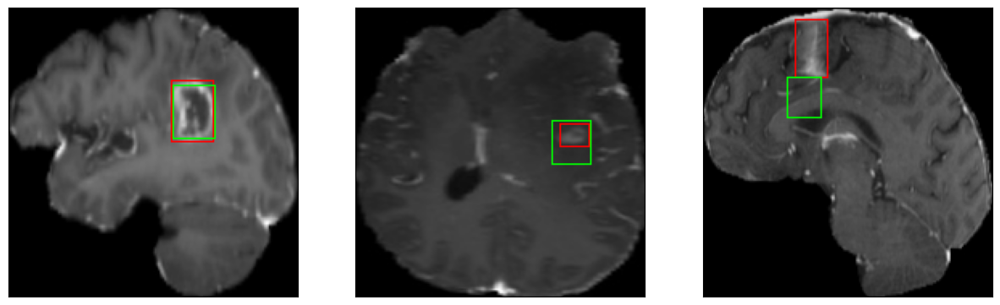

50/50 [==============================] - 10s 196ms/step - loss: 5.4459 - IoU: 0.5634 - val_loss: 7.3978 - val_IoU: 0.4650
Epoch 93/100
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4
7/7 [==============================] - 0s 41ms/step
4


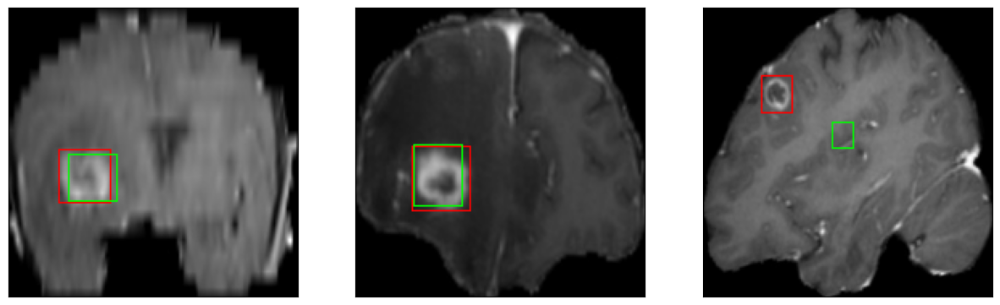

50/50 [==============================] - 10s 200ms/step - loss: 5.0812 - IoU: 0.5778 - val_loss: 7.4007 - val_IoU: 0.4846
Epoch 94/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4


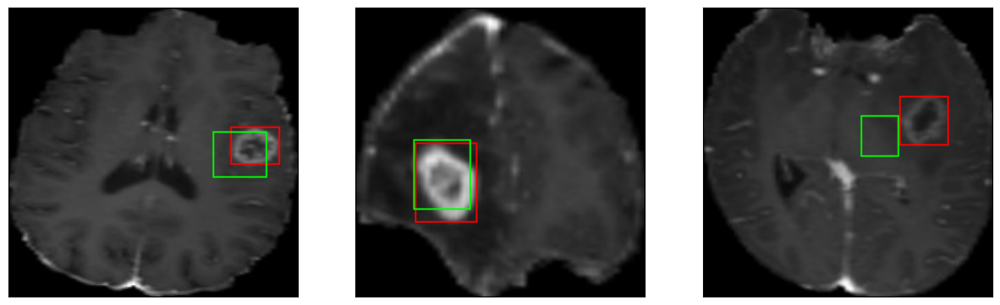

50/50 [==============================] - 10s 197ms/step - loss: 5.0279 - IoU: 0.5761 - val_loss: 7.5623 - val_IoU: 0.4656
Epoch 95/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


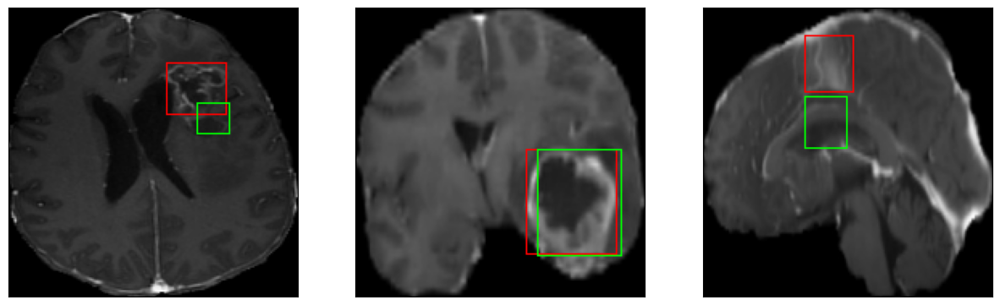

50/50 [==============================] - 10s 195ms/step - loss: 5.0539 - IoU: 0.5793 - val_loss: 7.2251 - val_IoU: 0.4966
Epoch 96/100
7/7 [==============================] - 0s 42ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 43ms/step
4


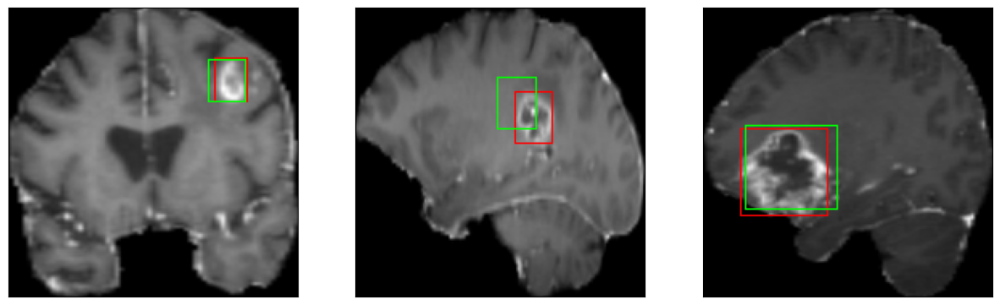

50/50 [==============================] - 10s 202ms/step - loss: 4.7497 - IoU: 0.5914 - val_loss: 6.5930 - val_IoU: 0.5035
Epoch 97/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 41ms/step
4


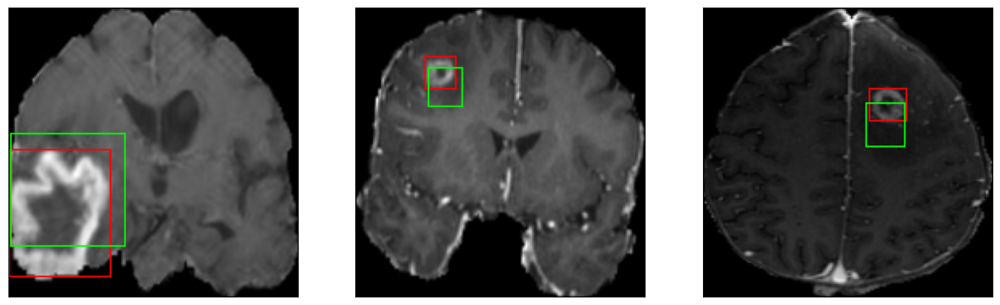

50/50 [==============================] - 10s 195ms/step - loss: 4.9139 - IoU: 0.5810 - val_loss: 7.0788 - val_IoU: 0.4602
Epoch 98/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


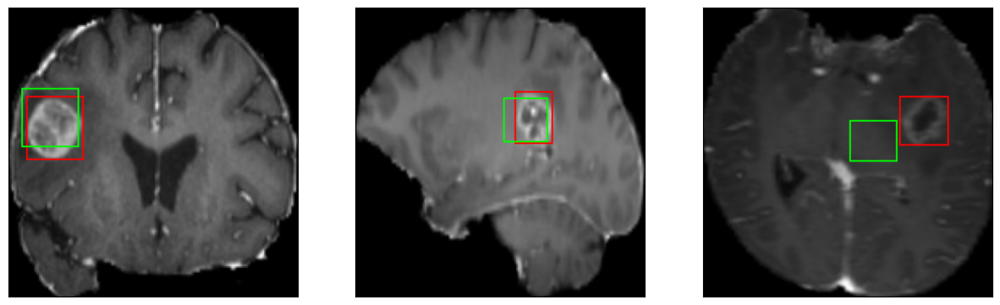

50/50 [==============================] - 10s 196ms/step - loss: 4.9598 - IoU: 0.5802 - val_loss: 7.2010 - val_IoU: 0.4832
Epoch 99/100
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4
7/7 [==============================] - 0s 40ms/step
4


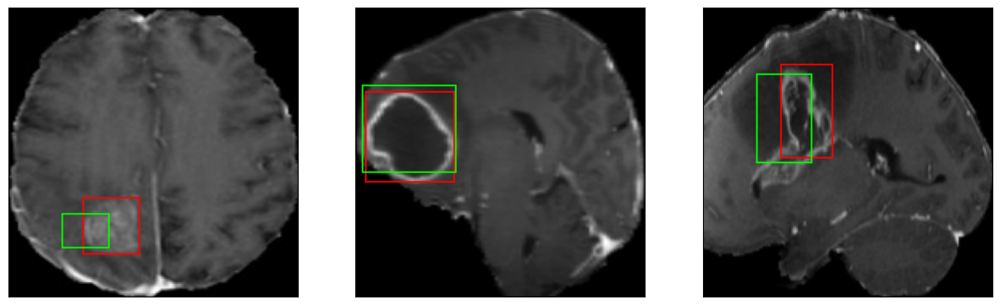

50/50 [==============================] - 10s 207ms/step - loss: 4.9435 - IoU: 0.5842 - val_loss: 7.3208 - val_IoU: 0.4483
Epoch 100/100
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4
7/7 [==============================] - 0s 39ms/step
4


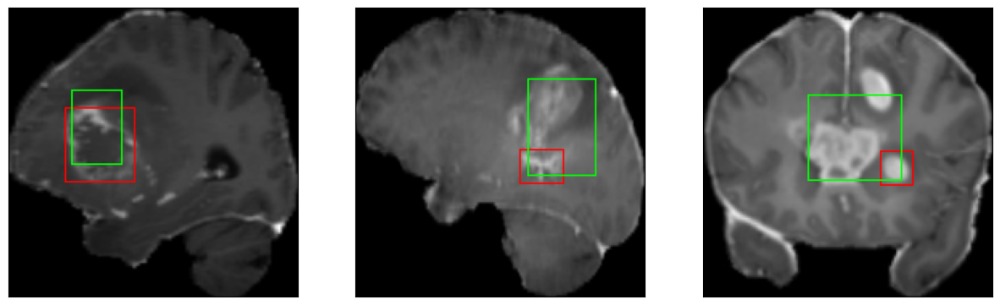

50/50 [==============================] - 10s 197ms/step - loss: 5.2603 - IoU: 0.5570 - val_loss: 7.5420 - val_IoU: 0.4795


In [23]:
model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

<Axes: >

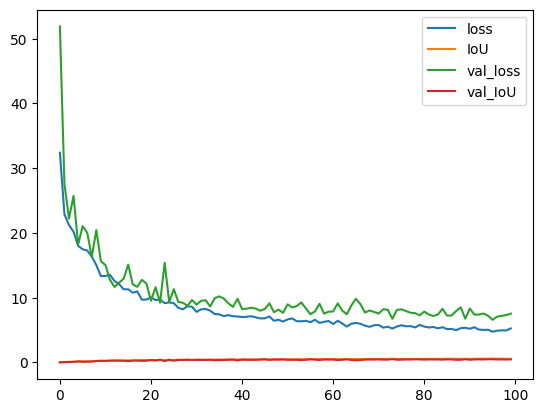

In [24]:
pd.DataFrame(model.history.history).plot()

In [28]:
model.evaluate(test_dataset)

7/7 [==============================] - 1s 53ms/step - loss: 9.0709 - IoU: 0.4392


[9.070940971374512, 0.43921011686325073]

In [ ]:
#Save model
model.save('./model_fromScratch')

In [ ]:
#Load model
model = tf.keras.models.load_model('./model_fromScratch')